In [609]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler, StandardScaler
from sklearn.metrics import classification_report, mean_squared_error, mean_absolute_error, r2_score, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, precision_recall_curve
import warnings
warnings.filterwarnings('ignore', category=UserWarning)
import time # to measure how long the models take
import math
import statsmodels.api as sm
from sklearn.model_selection import train_test_split

In [610]:
df_players = pd.read_csv(r"C:\Users\gabri\Documents\player_stats_dataset.csv")
df_goalies = pd.read_csv(r"C:\Users\gabri\Documents\goalie_stats_data.csv")

C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\1507480478.py:1: DtypeWarning: Columns (1,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,25,26,27,28) have mixed types. Specify dtype option on import or set low_memory=False.
  df_players = pd.read_csv(r"C:\Users\gabri\Documents\player_stats_dataset.csv")


In [611]:
df_players.drop_duplicates(inplace=True)
df_goalies.drop_duplicates(inplace=True)

In [612]:
df_players.head()

,Unnamed: 0_level_0,Unnamed: 1_level_0,Unnamed: 2_level_0,Unnamed: 3_level_0,Unnamed: 4_level_0,Scoring,Scoring.1,Scoring.2,Unnamed: 8_level_0,Unnamed: 9_level_0,...,Unnamed: 22_level_0,Unnamed: 23_level_0,Unnamed: 24_level_0,Unnamed: 25_level_0,Unnamed: 26_level_0,Unnamed: 27_level_0,Unnamed: 28_level_0,Unnamed: 29_level_0,Player Links,Unnamed: 21_level_0
0,Season,Age,Tm,Lg,GP,G,A,PTS,+/-,PIM,...,FOW,FOL,FO%,BLK,HIT,TK,GV,Awards,NaN,Awards
1,2007-08,20.0,DET,NHL,2,0,0,0,0.0,2.0,...,5.0,7.0,41.7,0.0,5.0,1.0,0.0,NaN,/players/a/abdelju01.html,NaN
2,2008-09,21.0,DET,NHL,2,0,0,0,0.0,0.0,...,4.0,3.0,57.1,0.0,3.0,0.0,1.0,NaN,/players/a/abdelju01.html,NaN
3,2009-10,22.0,DET,NHL,50,3,3,6,-11.0,35.0,...,148.0,170.0,46.5,20.0,152.0,7.0,7.0,NaN,/players/a/abdelju01.html,NaN
4,2010-11,23.0,DET,NHL,74,7,12,19,15.0,61.0,...,227.0,203.0,52.8,39.0,188.0,17.0,20.0,NaN,/players/a/abdelju01.html,NaN


In [613]:
df_goalies.head(30)

,Unnamed: 0_level_0,Unnamed: 1_level_0,Unnamed: 2_level_0,Unnamed: 3_level_0,Goalie Stats,Goalie Stats.1,Goalie Stats.2,Goalie Stats.3,Goalie Stats.4,Goalie Stats.5,...,Goalie Stats.15,Goalie Stats.16,Unnamed: 21_level_0,Unnamed: 22_level_0,Scoring,Scoring.1,Scoring.2,Unnamed: 26_level_0,Unnamed: 27_level_0,Player Links
0,Season,Age,Tm,Lg,GP,GS,W,L,T/O,GA,...,GA%-,GSAA,adjGAA,GPS,G,A,PTS,PIM,Awards,NaN
1,2000-01,22.0,COL,NHL,26,NaN,12.0,7.0,3.0,52,...,100.0,0.0,2.54,3.3,0,1.0,1.0,0,NaN,/players/a/aebisda01.html
2,2001-02,23.0,COL,NHL,21,NaN,13.0,6.0,0.0,37,...,75.0,12.6,2.23,4.8,0,0.0,0.0,4,NaN,/players/a/aebisda01.html
3,2002-03,24.0,COL,NHL,22,NaN,7.0,12.0,0.0,50,...,92.0,4.1,2.87,4.1,0,0.0,0.0,4,NaN,/players/a/aebisda01.html
4,2003-04,25.0,COL,NHL,62,NaN,32.0,19.0,9.0,129,...,85.0,22.7,2.53,13.1,0,1.0,1.0,4,NaN,/players/a/aebisda01.html
5,2005-06,27.0,TOT,NHL,50,NaN,29.0,17.0,2.0,149,...,102.0,-3.6,3.17,8.6,0,3.0,3.0,16,NaN,/players/a/aebisda01.html
6,2005-06,27.0,COL,NHL,43,NaN,25.0,14.0,2.0,123,...,101.0,-1.3,3.05,7.3,0,3.0,3.0,16,NaN,/players/a/aebisda01.html
7,2005-06,27.0,MTL,NHL,7,NaN,4.0,3.0,0.0,26,...,NaN,NaN,3.87,1.2,0,0.0,0.0,0,NaN,/players/a/aebisda01.html
8,2006-07,28.0,MTL,NHL,32,NaN,13.0,12.0,3.0,93,...,106.0,-5.0,3.44,5.1,0,0.0,0.0,2,NaN,/players/a/aebisda01.html
9,2007-08,29.0,PHX,NHL,1,1.0,0.0,1.0,0.0,3,...,NaN,NaN,3.0,0.2,0,0.0,0.0,0,NaN,/players/a/aebisda01.html


In [614]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52100 entries, 0 to 52099
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Unnamed: 0_level_0   52100 non-null  object
 1   Unnamed: 1_level_0   37312 non-null  object
 2   Unnamed: 2_level_0   52100 non-null  object
 3   Unnamed: 3_level_0   52100 non-null  object
 4   Unnamed: 4_level_0   52100 non-null  object
 5   Scoring              52100 non-null  object
 6   Scoring.1            52100 non-null  object
 7   Scoring.2            52100 non-null  object
 8   Unnamed: 8_level_0   52075 non-null  object
 9   Unnamed: 9_level_0   52098 non-null  object
 10  Goals                52087 non-null  object
 11  Goals.1              52087 non-null  object
 12  Goals.2              52087 non-null  object
 13  Goals.3              51899 non-null  object
 14  Assists              51792 non-null  object
 15  Assists.1            51792 non-null  object
 16  Assi

In [615]:
df_goalies.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5124 entries, 0 to 5123
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Unnamed: 0_level_0   5124 non-null   object
 1   Unnamed: 1_level_0   3614 non-null   object
 2   Unnamed: 2_level_0   5124 non-null   object
 3   Unnamed: 3_level_0   5124 non-null   object
 4   Goalie Stats         5124 non-null   object
 5   Goalie Stats.1       2341 non-null   object
 6   Goalie Stats.2       5121 non-null   object
 7   Goalie Stats.3       5121 non-null   object
 8   Goalie Stats.4       5121 non-null   object
 9   Goalie Stats.5       5124 non-null   object
 10  Goalie Stats.6       5074 non-null   object
 11  Goalie Stats.7       5074 non-null   object
 12  Goalie Stats.8       5068 non-null   object
 13  Goalie Stats.9       5124 non-null   object
 14  Goalie Stats.10      5124 non-null   object
 15  Goalie Stats.11      5124 non-null   object
 16  Goalie

In [616]:
df_players = df_players.dropna(subset=['Unnamed: 1_level_0'])
df_goalies = df_goalies.dropna(subset=['Unnamed: 1_level_0'])

In [617]:
df_players.head(30)

,Unnamed: 0_level_0,Unnamed: 1_level_0,Unnamed: 2_level_0,Unnamed: 3_level_0,Unnamed: 4_level_0,Scoring,Scoring.1,Scoring.2,Unnamed: 8_level_0,Unnamed: 9_level_0,...,Unnamed: 22_level_0,Unnamed: 23_level_0,Unnamed: 24_level_0,Unnamed: 25_level_0,Unnamed: 26_level_0,Unnamed: 27_level_0,Unnamed: 28_level_0,Unnamed: 29_level_0,Player Links,Unnamed: 21_level_0
0,Season,Age,Tm,Lg,GP,G,A,PTS,+/-,PIM,...,FOW,FOL,FO%,BLK,HIT,TK,GV,Awards,NaN,Awards
1,2007-08,20.0,DET,NHL,2,0,0,0,0.0,2.0,...,5.0,7.0,41.7,0.0,5.0,1.0,0.0,NaN,/players/a/abdelju01.html,NaN
2,2008-09,21.0,DET,NHL,2,0,0,0,0.0,0.0,...,4.0,3.0,57.1,0.0,3.0,0.0,1.0,NaN,/players/a/abdelju01.html,NaN
3,2009-10,22.0,DET,NHL,50,3,3,6,-11.0,35.0,...,148.0,170.0,46.5,20.0,152.0,7.0,7.0,NaN,/players/a/abdelju01.html,NaN
4,2010-11,23.0,DET,NHL,74,7,12,19,15.0,61.0,...,227.0,203.0,52.8,39.0,188.0,17.0,20.0,NaN,/players/a/abdelju01.html,NaN
5,2011-12,24.0,DET,NHL,81,8,14,22,4.0,62.0,...,239.0,213.0,52.9,42.0,148.0,16.0,14.0,NaN,/players/a/abdelju01.html,NaN
6,2012-13,25.0,DET,NHL,48,10,3,13,6.0,34.0,...,65.0,60.0,52.0,13.0,120.0,10.0,10.0,NaN,/players/a/abdelju01.html,NaN
7,2013-14,26.0,DET,NHL,70,10,18,28,2.0,31.0,...,23.0,32.0,41.8,31.0,172.0,21.0,15.0,NaN,/players/a/abdelju01.html,NaN
8,2014-15,27.0,DET,NHL,71,23,21,44,3.0,72.0,...,7.0,8.0,46.7,28.0,153.0,16.0,29.0,NaN,/players/a/abdelju01.html,NaN
9,2015-16,28.0,DET,NHL,82,19,23,42,-16.0,120.0,...,5.0,9.0,35.7,44.0,207.0,23.0,29.0,NaN,/players/a/abdelju01.html,NaN


In [618]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
Index: 37312 entries, 0 to 52092
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Unnamed: 0_level_0   37312 non-null  object
 1   Unnamed: 1_level_0   37312 non-null  object
 2   Unnamed: 2_level_0   37312 non-null  object
 3   Unnamed: 3_level_0   37312 non-null  object
 4   Unnamed: 4_level_0   37312 non-null  object
 5   Scoring              37312 non-null  object
 6   Scoring.1            37312 non-null  object
 7   Scoring.2            37312 non-null  object
 8   Unnamed: 8_level_0   37298 non-null  object
 9   Unnamed: 9_level_0   37310 non-null  object
 10  Goals                37307 non-null  object
 11  Goals.1              37307 non-null  object
 12  Goals.2              37307 non-null  object
 13  Goals.3              37196 non-null  object
 14  Assists              37148 non-null  object
 15  Assists.1            37148 non-null  object
 16  Assists.2

In [619]:
df_players.iloc[:,:10]

,Unnamed: 0_level_0,Unnamed: 1_level_0,Unnamed: 2_level_0,Unnamed: 3_level_0,Unnamed: 4_level_0,Scoring,Scoring.1,Scoring.2,Unnamed: 8_level_0,Unnamed: 9_level_0
0,Season,Age,Tm,Lg,GP,G,A,PTS,+/-,PIM
1,2007-08,20.0,DET,NHL,2,0,0,0,0.0,2.0
2,2008-09,21.0,DET,NHL,2,0,0,0,0.0,0.0
3,2009-10,22.0,DET,NHL,50,3,3,6,-11.0,35.0
4,2010-11,23.0,DET,NHL,74,7,12,19,15.0,61.0
...,...,...,...,...,...,...,...,...,...,...
52088,2002-03,25.0,MIN,NHL,66,4,12,16,-7.0,34.0
52089,2003-04,26.0,MIN,NHL,65,8,13,21,4.0,48.0
52090,2005-06,28.0,MIN,NHL,57,7,11,18,-12.0,50.0
52091,2006-07,29.0,CGY,NHL,49,1,5,6,-2.0,30.0


In [620]:
new_headers = df_players.iloc[0, :10].tolist()
new_headers2 = df_players.iloc[0, 22:30].tolist()
df_players = df_players[1:]
df_players.columns = pd.Index(new_headers + df_players.columns[10:22].tolist() + new_headers2 + df_players.columns[30:32].tolist())

In [621]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
Index: 37311 entries, 1 to 52092
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Season               37311 non-null  object
 1   Age                  37311 non-null  object
 2   Tm                   37311 non-null  object
 3   Lg                   37311 non-null  object
 4   GP                   37311 non-null  object
 5   G                    37311 non-null  object
 6   A                    37311 non-null  object
 7   PTS                  37311 non-null  object
 8   +/-                  37297 non-null  object
 9   PIM                  37309 non-null  object
 10  Goals                37306 non-null  object
 11  Goals.1              37306 non-null  object
 12  Goals.2              37306 non-null  object
 13  Goals.3              37195 non-null  object
 14  Assists              37147 non-null  object
 15  Assists.1            37147 non-null  object
 16  Assists.2

In [622]:
df_players.head()

,Season,Age,Tm,Lg,GP,G,A,PTS,+/-,PIM,...,FOW,FOL,FO%,BLK,HIT,TK,GV,Awards,Player Links,Unnamed: 21_level_0
1,2007-08,20.0,DET,NHL,2,0,0,0,0.0,2.0,...,5.0,7.0,41.7,0.0,5.0,1.0,0.0,NaN,/players/a/abdelju01.html,NaN
2,2008-09,21.0,DET,NHL,2,0,0,0,0.0,0.0,...,4.0,3.0,57.1,0.0,3.0,0.0,1.0,NaN,/players/a/abdelju01.html,NaN
3,2009-10,22.0,DET,NHL,50,3,3,6,-11.0,35.0,...,148.0,170.0,46.5,20.0,152.0,7.0,7.0,NaN,/players/a/abdelju01.html,NaN
4,2010-11,23.0,DET,NHL,74,7,12,19,15.0,61.0,...,227.0,203.0,52.8,39.0,188.0,17.0,20.0,NaN,/players/a/abdelju01.html,NaN
5,2011-12,24.0,DET,NHL,81,8,14,22,4.0,62.0,...,239.0,213.0,52.9,42.0,148.0,16.0,14.0,NaN,/players/a/abdelju01.html,NaN


In [623]:
df_players.iloc[:,10:22]

,Goals,Goals.1,Goals.2,Goals.3,Assists,Assists.1,Assists.2,Shots,Shots.1,Shots.2,Ice Time,Ice Time.1
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,8.0,24.0,12:13
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,7.0,19.0,9:18
3,3.0,0.0,0.0,0.0,3.0,0.0,0.0,79.0,3.8,141.0,530.0,10:35
4,7.0,0.0,0.0,1.0,11.0,0.0,1.0,129.0,5.4,226.0,910.0,12:18
5,8.0,0.0,0.0,1.0,14.0,0.0,0.0,121.0,6.6,196.0,997.0,12:19
...,...,...,...,...,...,...,...,...,...,...,...,...
52088,2.0,2.0,0.0,0.0,4.0,5.0,3.0,113.0,3.5,NaN,1428.0,21:38
52089,4.0,4.0,0.0,1.0,9.0,4.0,0.0,104.0,7.7,NaN,1324.0,20:22
52090,3.0,4.0,0.0,1.0,7.0,4.0,0.0,80.0,8.8,NaN,1076.0,18:53
52091,1.0,0.0,0.0,0.0,5.0,0.0,0.0,36.0,2.8,NaN,677.0,13:49


In [624]:
df_players.rename(columns={'Goals': 'Even Strength Goals', 'Goals.1': 'Power Play Goals', 'Goals.2':'Short Handed Goals', 
                           'Goals.3': 'Game Winning Goals', 'Assists': 'Even Strength Assists', 'Assists.1': 'Power Play Assists', 
                           'Assists.2': 'Short Handed Assists', 'Shots': 'Shots on Goal', 'Shots.1': 'Shooting Percentage', 
                           'Shots.2': 'Total Shot Attempts', 'Ice Time': 'Total Ice Time', 'Ice Time.1': 'Average Time on Ice'}, inplace=True)

In [625]:
df_players.iloc[:,10:22]

,Even Strength Goals,Power Play Goals,Short Handed Goals,Game Winning Goals,Even Strength Assists,Power Play Assists,Short Handed Assists,Shots on Goal,Shooting Percentage,Total Shot Attempts,Total Ice Time,Average Time on Ice
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,8.0,24.0,12:13
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,7.0,19.0,9:18
3,3.0,0.0,0.0,0.0,3.0,0.0,0.0,79.0,3.8,141.0,530.0,10:35
4,7.0,0.0,0.0,1.0,11.0,0.0,1.0,129.0,5.4,226.0,910.0,12:18
5,8.0,0.0,0.0,1.0,14.0,0.0,0.0,121.0,6.6,196.0,997.0,12:19
...,...,...,...,...,...,...,...,...,...,...,...,...
52088,2.0,2.0,0.0,0.0,4.0,5.0,3.0,113.0,3.5,NaN,1428.0,21:38
52089,4.0,4.0,0.0,1.0,9.0,4.0,0.0,104.0,7.7,NaN,1324.0,20:22
52090,3.0,4.0,0.0,1.0,7.0,4.0,0.0,80.0,8.8,NaN,1076.0,18:53
52091,1.0,0.0,0.0,0.0,5.0,0.0,0.0,36.0,2.8,NaN,677.0,13:49


In [626]:
df_players.iloc[:,22:]

,FOW,FOL,FO%,BLK,HIT,TK,GV,Awards,Player Links,Unnamed: 21_level_0
1,5.0,7.0,41.7,0.0,5.0,1.0,0.0,NaN,/players/a/abdelju01.html,NaN
2,4.0,3.0,57.1,0.0,3.0,0.0,1.0,NaN,/players/a/abdelju01.html,NaN
3,148.0,170.0,46.5,20.0,152.0,7.0,7.0,NaN,/players/a/abdelju01.html,NaN
4,227.0,203.0,52.8,39.0,188.0,17.0,20.0,NaN,/players/a/abdelju01.html,NaN
5,239.0,213.0,52.9,42.0,148.0,16.0,14.0,NaN,/players/a/abdelju01.html,NaN
...,...,...,...,...,...,...,...,...,...,...
52088,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/players/z/zyuzian01.html,NaN
52089,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/players/z/zyuzian01.html,NaN
52090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/players/z/zyuzian01.html,NaN
52091,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/players/z/zyuzian01.html,NaN


In [627]:
df_players = df_players.drop(columns=['Unnamed: 21_level_0'])

In [628]:
df_players.head()

,Season,Age,Tm,Lg,GP,G,A,PTS,+/-,PIM,...,Average Time on Ice,FOW,FOL,FO%,BLK,HIT,TK,GV,Awards,Player Links
1,2007-08,20.0,DET,NHL,2,0,0,0,0.0,2.0,...,12:13,5.0,7.0,41.7,0.0,5.0,1.0,0.0,NaN,/players/a/abdelju01.html
2,2008-09,21.0,DET,NHL,2,0,0,0,0.0,0.0,...,9:18,4.0,3.0,57.1,0.0,3.0,0.0,1.0,NaN,/players/a/abdelju01.html
3,2009-10,22.0,DET,NHL,50,3,3,6,-11.0,35.0,...,10:35,148.0,170.0,46.5,20.0,152.0,7.0,7.0,NaN,/players/a/abdelju01.html
4,2010-11,23.0,DET,NHL,74,7,12,19,15.0,61.0,...,12:18,227.0,203.0,52.8,39.0,188.0,17.0,20.0,NaN,/players/a/abdelju01.html
5,2011-12,24.0,DET,NHL,81,8,14,22,4.0,62.0,...,12:19,239.0,213.0,52.9,42.0,148.0,16.0,14.0,NaN,/players/a/abdelju01.html


In [629]:
df_players = df_players.reset_index()

In [630]:
df_players = df_players.drop(columns=['index'])
df_players.head()

,Season,Age,Tm,Lg,GP,G,A,PTS,+/-,PIM,...,Average Time on Ice,FOW,FOL,FO%,BLK,HIT,TK,GV,Awards,Player Links
0,2007-08,20.0,DET,NHL,2,0,0,0,0.0,2.0,...,12:13,5.0,7.0,41.7,0.0,5.0,1.0,0.0,NaN,/players/a/abdelju01.html
1,2008-09,21.0,DET,NHL,2,0,0,0,0.0,0.0,...,9:18,4.0,3.0,57.1,0.0,3.0,0.0,1.0,NaN,/players/a/abdelju01.html
2,2009-10,22.0,DET,NHL,50,3,3,6,-11.0,35.0,...,10:35,148.0,170.0,46.5,20.0,152.0,7.0,7.0,NaN,/players/a/abdelju01.html
3,2010-11,23.0,DET,NHL,74,7,12,19,15.0,61.0,...,12:18,227.0,203.0,52.8,39.0,188.0,17.0,20.0,NaN,/players/a/abdelju01.html
4,2011-12,24.0,DET,NHL,81,8,14,22,4.0,62.0,...,12:19,239.0,213.0,52.9,42.0,148.0,16.0,14.0,NaN,/players/a/abdelju01.html


In [631]:
df_goalies.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3614 entries, 0 to 5118
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Unnamed: 0_level_0   3614 non-null   object
 1   Unnamed: 1_level_0   3614 non-null   object
 2   Unnamed: 2_level_0   3614 non-null   object
 3   Unnamed: 3_level_0   3614 non-null   object
 4   Goalie Stats         3614 non-null   object
 5   Goalie Stats.1       1581 non-null   object
 6   Goalie Stats.2       3612 non-null   object
 7   Goalie Stats.3       3612 non-null   object
 8   Goalie Stats.4       3612 non-null   object
 9   Goalie Stats.5       3614 non-null   object
 10  Goalie Stats.6       3583 non-null   object
 11  Goalie Stats.7       3583 non-null   object
 12  Goalie Stats.8       3578 non-null   object
 13  Goalie Stats.9       3614 non-null   object
 14  Goalie Stats.10      3614 non-null   object
 15  Goalie Stats.11      3614 non-null   object
 16  Goalie Stat

In [632]:
df_goalies.iloc[:,:10]

,Unnamed: 0_level_0,Unnamed: 1_level_0,Unnamed: 2_level_0,Unnamed: 3_level_0,Goalie Stats,Goalie Stats.1,Goalie Stats.2,Goalie Stats.3,Goalie Stats.4,Goalie Stats.5
0,Season,Age,Tm,Lg,GP,GS,W,L,T/O,GA
1,2000-01,22.0,COL,NHL,26,NaN,12.0,7.0,3.0,52
2,2001-02,23.0,COL,NHL,21,NaN,13.0,6.0,0.0,37
3,2002-03,24.0,COL,NHL,22,NaN,7.0,12.0,0.0,50
4,2003-04,25.0,COL,NHL,62,NaN,32.0,19.0,9.0,129
...,...,...,...,...,...,...,...,...,...,...
5114,1990-91,27.0,PIT,NHL,18,NaN,4.0,6.0,2.0,52
5115,1991-92,28.0,PIT,NHL,18,NaN,7.0,6.0,0.0,53
5116,1992-93,29.0,TBL,NHL,31,NaN,7.0,19.0,2.0,97
5117,1993-94,30.0,TBL,NHL,9,NaN,2.0,3.0,1.0,20


In [633]:
df_goalies.iloc[:,10:20]

,Goalie Stats.6,Goalie Stats.7,Goalie Stats.8,Goalie Stats.9,Goalie Stats.10,Goalie Stats.11,Goalie Stats.12,Goalie Stats.13,Goalie Stats.14,Goalie Stats.15
0,SA,SV,SV%,GAA,SO,MIN,QS,QS%,RBS,GA%-
1,538.0,486.0,0.903,2.24,3,1393,NaN,NaN,NaN,100.0
2,538.0,501.0,0.931,1.88,2,1184,NaN,NaN,NaN,75.0
3,593.0,543.0,0.916,2.43,1,1235,NaN,NaN,NaN,92.0
4,1703.0,1574.0,0.924,2.09,4,3703,NaN,NaN,NaN,85.0
...,...,...,...,...,...,...,...,...,...,...
5114,428.0,376.0,0.879,4.04,0,773,NaN,NaN,NaN,107.0
5115,476.0,423.0,0.889,3.8,0,838,NaN,NaN,NaN,100.0
5116,758.0,661.0,0.872,3.66,0,1591,NaN,NaN,NaN,111.0
5117,211.0,191.0,0.905,2.5,1,480,NaN,NaN,NaN,NaN


In [634]:
df_goalies.iloc[:,20:]

,Goalie Stats.16,Unnamed: 21_level_0,Unnamed: 22_level_0,Scoring,Scoring.1,Scoring.2,Unnamed: 26_level_0,Unnamed: 27_level_0,Player Links
0,GSAA,adjGAA,GPS,G,A,PTS,PIM,Awards,NaN
1,0.0,2.54,3.3,0,1.0,1.0,0,NaN,/players/a/aebisda01.html
2,12.6,2.23,4.8,0,0.0,0.0,4,NaN,/players/a/aebisda01.html
3,4.1,2.87,4.1,0,0.0,0.0,4,NaN,/players/a/aebisda01.html
4,22.7,2.53,13.1,0,1.0,1.0,4,NaN,/players/a/aebisda01.html
...,...,...,...,...,...,...,...,...,...
5114,-3.2,3.65,2.1,0,1.0,1.0,0,NaN,/players/y/youngwe01.html
5115,0.2,3.37,2.6,0,0.0,0.0,0,NaN,/players/y/youngwe01.html
5116,-9.8,3.09,3.2,0,2.0,2.0,2,NaN,/players/y/youngwe01.html
5117,NaN,2.38,1.3,0,0.0,0.0,4,NaN,/players/y/youngwe01.html


In [635]:
new_headers = df_goalies.iloc[0, :28].tolist()
df_goalies = df_goalies[1:]
df_goalies.columns = pd.Index(new_headers + df_goalies.columns[28:30].tolist())

In [636]:
df_goalies.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3613 entries, 1 to 5118
Data columns (total 29 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Season        3613 non-null   object
 1   Age           3613 non-null   object
 2   Tm            3613 non-null   object
 3   Lg            3613 non-null   object
 4   GP            3613 non-null   object
 5   GS            1580 non-null   object
 6   W             3611 non-null   object
 7   L             3611 non-null   object
 8   T/O           3611 non-null   object
 9   GA            3613 non-null   object
 10  SA            3582 non-null   object
 11  SV            3582 non-null   object
 12  SV%           3577 non-null   object
 13  GAA           3613 non-null   object
 14  SO            3613 non-null   object
 15  MIN           3613 non-null   object
 16  QS            1580 non-null   object
 17  QS%           1537 non-null   object
 18  RBS           1580 non-null   object
 19  GA%-       

In [637]:
df_goalies.head()

,Season,Age,Tm,Lg,GP,GS,W,L,T/O,GA,...,GA%-,GSAA,adjGAA,GPS,G,A,PTS,PIM,Awards,Player Links
1,2000-01,22.0,COL,NHL,26,NaN,12.0,7.0,3.0,52,...,100.0,0.0,2.54,3.3,0,1.0,1.0,0,NaN,/players/a/aebisda01.html
2,2001-02,23.0,COL,NHL,21,NaN,13.0,6.0,0.0,37,...,75.0,12.6,2.23,4.8,0,0.0,0.0,4,NaN,/players/a/aebisda01.html
3,2002-03,24.0,COL,NHL,22,NaN,7.0,12.0,0.0,50,...,92.0,4.1,2.87,4.1,0,0.0,0.0,4,NaN,/players/a/aebisda01.html
4,2003-04,25.0,COL,NHL,62,NaN,32.0,19.0,9.0,129,...,85.0,22.7,2.53,13.1,0,1.0,1.0,4,NaN,/players/a/aebisda01.html
5,2005-06,27.0,TOT,NHL,50,NaN,29.0,17.0,2.0,149,...,102.0,-3.6,3.17,8.6,0,3.0,3.0,16,NaN,/players/a/aebisda01.html


In [638]:
df_goalies = df_goalies.reset_index()
df_goalies = df_goalies.drop(columns=['index'])
df_goalies.head(10)

,Season,Age,Tm,Lg,GP,GS,W,L,T/O,GA,...,GA%-,GSAA,adjGAA,GPS,G,A,PTS,PIM,Awards,Player Links
0,2000-01,22.0,COL,NHL,26,NaN,12.0,7.0,3.0,52,...,100.0,0.0,2.54,3.3,0,1.0,1.0,0,NaN,/players/a/aebisda01.html
1,2001-02,23.0,COL,NHL,21,NaN,13.0,6.0,0.0,37,...,75.0,12.6,2.23,4.8,0,0.0,0.0,4,NaN,/players/a/aebisda01.html
2,2002-03,24.0,COL,NHL,22,NaN,7.0,12.0,0.0,50,...,92.0,4.1,2.87,4.1,0,0.0,0.0,4,NaN,/players/a/aebisda01.html
3,2003-04,25.0,COL,NHL,62,NaN,32.0,19.0,9.0,129,...,85.0,22.7,2.53,13.1,0,1.0,1.0,4,NaN,/players/a/aebisda01.html
4,2005-06,27.0,TOT,NHL,50,NaN,29.0,17.0,2.0,149,...,102.0,-3.6,3.17,8.6,0,3.0,3.0,16,NaN,/players/a/aebisda01.html
5,2005-06,27.0,COL,NHL,43,NaN,25.0,14.0,2.0,123,...,101.0,-1.3,3.05,7.3,0,3.0,3.0,16,NaN,/players/a/aebisda01.html
6,2005-06,27.0,MTL,NHL,7,NaN,4.0,3.0,0.0,26,...,NaN,NaN,3.87,1.2,0,0.0,0.0,0,NaN,/players/a/aebisda01.html
7,2006-07,28.0,MTL,NHL,32,NaN,13.0,12.0,3.0,93,...,106.0,-5.0,3.44,5.1,0,0.0,0.0,2,NaN,/players/a/aebisda01.html
8,2007-08,29.0,PHX,NHL,1,1.0,0.0,1.0,0.0,3,...,NaN,NaN,3.0,0.2,0,0.0,0.0,0,NaN,/players/a/aebisda01.html
9,2012-13,22.0,STL,NHL,15,13.0,9.0,4.0,0.0,33,...,108.0,-2.5,2.91,1.8,0,0.0,0.0,0,"AR-1,Calder-17",/players/a/allenja01.html


In [639]:
df_names = pd.read_csv(r"C:\Users\gabri\Documents\nhl_players_dataset.csv")

In [640]:
df_names.head(20)

,Antti Aalto,/players/a/aaltoan01.html,C,1998,2001
0,George Abbott,/players/a/abbotge01.html,G,1944,1944
1,Reg Abbott,/players/a/abbotre01.html,C,1953,1953
2,Spencer Abbott,/players/a/abbotsp01.html,LW,2014,2017
3,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020
4,Clarence Abel,/players/a/abelcl01.html,D,1927,1934
5,Gerry Abel,/players/a/abelge01.html,LW,1967,1967
6,Sid Abel,/players/a/abelsi01.html,C/LW,1939,1954
7,Pontus Åberg,/players/a/abergpo01.html,LW,2017,2020
8,Dennis Abgrall,/players/a/abgrade01.html,RW,1976,1976
9,Ramzi Abid,/players/a/abidra01.html,LW,2003,2007


In [641]:
df_names.columns = ["Player Name", "Player Link", "Position", "Debut Year", "Final Year"]
df_names.head(20)

,Player Name,Player Link,Position,Debut Year,Final Year
0,George Abbott,/players/a/abbotge01.html,G,1944,1944
1,Reg Abbott,/players/a/abbotre01.html,C,1953,1953
2,Spencer Abbott,/players/a/abbotsp01.html,LW,2014,2017
3,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020
4,Clarence Abel,/players/a/abelcl01.html,D,1927,1934
5,Gerry Abel,/players/a/abelge01.html,LW,1967,1967
6,Sid Abel,/players/a/abelsi01.html,C/LW,1939,1954
7,Pontus Åberg,/players/a/abergpo01.html,LW,2017,2020
8,Dennis Abgrall,/players/a/abgrade01.html,RW,1976,1976
9,Ramzi Abid,/players/a/abidra01.html,LW,2003,2007


In [642]:
df_players = pd.merge(df_players, df_names, left_on='Player Links', right_on='Player Link', how='inner')
df_goalies = pd.merge(df_goalies, df_names, left_on='Player Links', right_on='Player Link', how='inner')

In [643]:
df_players.iloc[:,17:].head(15)

,Shots on Goal,Shooting Percentage,Total Shot Attempts,Total Ice Time,Average Time on Ice,FOW,FOL,FO%,BLK,HIT,TK,GV,Awards,Player Links,Player Name,Player Link,Position,Debut Year,Final Year
0,6.0,0.0,8.0,24.0,12:13,5.0,7.0,41.7,0.0,5.0,1.0,0.0,NaN,/players/a/abdelju01.html,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020
1,2.0,0.0,7.0,19.0,9:18,4.0,3.0,57.1,0.0,3.0,0.0,1.0,NaN,/players/a/abdelju01.html,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020
2,79.0,3.8,141.0,530.0,10:35,148.0,170.0,46.5,20.0,152.0,7.0,7.0,NaN,/players/a/abdelju01.html,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020
3,129.0,5.4,226.0,910.0,12:18,227.0,203.0,52.8,39.0,188.0,17.0,20.0,NaN,/players/a/abdelju01.html,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020
4,121.0,6.6,196.0,997.0,12:19,239.0,213.0,52.9,42.0,148.0,16.0,14.0,NaN,/players/a/abdelju01.html,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020
5,96.0,10.4,147.0,711.0,14:49,65.0,60.0,52.0,13.0,120.0,10.0,10.0,NaN,/players/a/abdelju01.html,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020
6,147.0,6.8,223.0,1070.0,15:17,23.0,32.0,41.8,31.0,172.0,21.0,15.0,NaN,/players/a/abdelju01.html,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020
7,154.0,14.9,237.0,1272.0,17:55,7.0,8.0,46.7,28.0,153.0,16.0,29.0,NaN,/players/a/abdelju01.html,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020
8,155.0,12.3,239.0,1512.0,18:26,5.0,9.0,35.7,44.0,207.0,23.0,29.0,NaN,/players/a/abdelju01.html,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020
9,104.0,6.7,160.0,1066.0,16:40,5.0,12.0,29.4,27.0,144.0,15.0,18.0,NaN,/players/a/abdelju01.html,Justin Abdelkader,/players/a/abdelju01.html,LW,2008,2020


In [644]:
df_players = df_players.drop(columns=['Player Links', 'Player Link'])
df_players.head(15)

,Season,Age,Tm,Lg,GP,G,A,PTS,+/-,PIM,...,FO%,BLK,HIT,TK,GV,Awards,Player Name,Position,Debut Year,Final Year
0,2007-08,20.0,DET,NHL,2,0,0,0,0.0,2.0,...,41.7,0.0,5.0,1.0,0.0,NaN,Justin Abdelkader,LW,2008,2020
1,2008-09,21.0,DET,NHL,2,0,0,0,0.0,0.0,...,57.1,0.0,3.0,0.0,1.0,NaN,Justin Abdelkader,LW,2008,2020
2,2009-10,22.0,DET,NHL,50,3,3,6,-11.0,35.0,...,46.5,20.0,152.0,7.0,7.0,NaN,Justin Abdelkader,LW,2008,2020
3,2010-11,23.0,DET,NHL,74,7,12,19,15.0,61.0,...,52.8,39.0,188.0,17.0,20.0,NaN,Justin Abdelkader,LW,2008,2020
4,2011-12,24.0,DET,NHL,81,8,14,22,4.0,62.0,...,52.9,42.0,148.0,16.0,14.0,NaN,Justin Abdelkader,LW,2008,2020
5,2012-13,25.0,DET,NHL,48,10,3,13,6.0,34.0,...,52.0,13.0,120.0,10.0,10.0,NaN,Justin Abdelkader,LW,2008,2020
6,2013-14,26.0,DET,NHL,70,10,18,28,2.0,31.0,...,41.8,31.0,172.0,21.0,15.0,NaN,Justin Abdelkader,LW,2008,2020
7,2014-15,27.0,DET,NHL,71,23,21,44,3.0,72.0,...,46.7,28.0,153.0,16.0,29.0,NaN,Justin Abdelkader,LW,2008,2020
8,2015-16,28.0,DET,NHL,82,19,23,42,-16.0,120.0,...,35.7,44.0,207.0,23.0,29.0,NaN,Justin Abdelkader,LW,2008,2020
9,2016-17,29.0,DET,NHL,64,7,14,21,-20.0,50.0,...,29.4,27.0,144.0,15.0,18.0,NaN,Justin Abdelkader,LW,2008,2020


In [645]:
df_goalies = df_goalies.drop(columns=['Player Links', 'Player Link'])
df_goalies.head(15)

,Season,Age,Tm,Lg,GP,GS,W,L,T/O,GA,...,GPS,G,A,PTS,PIM,Awards,Player Name,Position,Debut Year,Final Year
0,2000-01,22.0,COL,NHL,26,NaN,12.0,7.0,3.0,52,...,3.3,0,1.0,1.0,0,NaN,David Aebischer,G,2001,2008
1,2001-02,23.0,COL,NHL,21,NaN,13.0,6.0,0.0,37,...,4.8,0,0.0,0.0,4,NaN,David Aebischer,G,2001,2008
2,2002-03,24.0,COL,NHL,22,NaN,7.0,12.0,0.0,50,...,4.1,0,0.0,0.0,4,NaN,David Aebischer,G,2001,2008
3,2003-04,25.0,COL,NHL,62,NaN,32.0,19.0,9.0,129,...,13.1,0,1.0,1.0,4,NaN,David Aebischer,G,2001,2008
4,2005-06,27.0,TOT,NHL,50,NaN,29.0,17.0,2.0,149,...,8.6,0,3.0,3.0,16,NaN,David Aebischer,G,2001,2008
5,2005-06,27.0,COL,NHL,43,NaN,25.0,14.0,2.0,123,...,7.3,0,3.0,3.0,16,NaN,David Aebischer,G,2001,2008
6,2005-06,27.0,MTL,NHL,7,NaN,4.0,3.0,0.0,26,...,1.2,0,0.0,0.0,0,NaN,David Aebischer,G,2001,2008
7,2006-07,28.0,MTL,NHL,32,NaN,13.0,12.0,3.0,93,...,5.1,0,0.0,0.0,2,NaN,David Aebischer,G,2001,2008
8,2007-08,29.0,PHX,NHL,1,1.0,0.0,1.0,0.0,3,...,0.2,0,0.0,0.0,0,NaN,David Aebischer,G,2001,2008
9,2012-13,22.0,STL,NHL,15,13.0,9.0,4.0,0.0,33,...,1.8,0,0.0,0.0,0,"AR-1,Calder-17",Jake Allen,G,2013,2024


In [646]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37311 entries, 0 to 37310
Data columns (total 34 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   Season                 37311 non-null  object
 1   Age                    37311 non-null  object
 2   Tm                     37311 non-null  object
 3   Lg                     37311 non-null  object
 4   GP                     37311 non-null  object
 5   G                      37311 non-null  object
 6   A                      37311 non-null  object
 7   PTS                    37311 non-null  object
 8   +/-                    37297 non-null  object
 9   PIM                    37309 non-null  object
 10  Even Strength Goals    37306 non-null  object
 11  Power Play Goals       37306 non-null  object
 12  Short Handed Goals     37306 non-null  object
 13  Game Winning Goals     37195 non-null  object
 14  Even Strength Assists  37147 non-null  object
 15  Power Play Assists 

In [647]:
df_players.iloc[:,19:].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37311 entries, 0 to 37310
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Total Shot Attempts  15164 non-null  object
 1   Total Ice Time       24430 non-null  object
 2   Average Time on Ice  24430 non-null  object
 3   FOW                  15998 non-null  object
 4   FOL                  15998 non-null  object
 5   FO%                  10190 non-null  object
 6   BLK                  15998 non-null  object
 7   HIT                  16003 non-null  object
 8   TK                   16003 non-null  object
 9   GV                   16003 non-null  object
 10  Awards               3265 non-null   object
 11  Player Name          37311 non-null  object
 12  Position             37311 non-null  object
 13  Debut Year           37311 non-null  int64 
 14  Final Year           37311 non-null  int64 
dtypes: int64(2), object(13)
memory usage: 4.3+ MB


In [648]:
df_players['Average Time on Ice'] = df_players['Average Time on Ice'].astype(str)
def convert_to_timedelta(time_str):
    try:
        # Split time string into minutes and seconds
        minutes, seconds = map(int, time_str.split(':'))
        # Create timedelta object
        return pd.Timedelta(minutes=minutes, seconds=seconds)
    except ValueError:
        return pd.NaT

In [649]:
#df_players['Season'] = pd.to_datetime(df_players['Season'])
df_players['Age'] = df_players['Age'].astype(float)
df_players['Tm'] = df_players['Tm'].astype(str)
df_players['GP'] = df_players['GP'].astype(int)
df_players['G'] = df_players['G'].astype(int)
df_players['A'] = df_players['A'].astype(int)
df_players['PTS'] = df_players['PTS'].astype(int)
df_players['+/-'] = df_players['+/-'].astype(float)
df_players['PIM'] = df_players['PIM'].astype(float)
df_players['Even Strength Goals'] = df_players['Even Strength Goals'].astype(float)
df_players['Power Play Goals'] = df_players['Power Play Goals'].astype(float)
df_players['Short Handed Goals'] = df_players['Short Handed Goals'].astype(float)
df_players['Game Winning Goals'] = df_players['Game Winning Goals'].astype(float)
df_players['Even Strength Assists'] = df_players['Even Strength Assists'].astype(float)
df_players['Power Play Assists'] = df_players['Power Play Assists'].astype(float)
df_players['Short Handed Assists'] = df_players['Short Handed Assists'].astype(float)
df_players['Shots on Goal'] = df_players['Shots on Goal'].astype(float)
df_players['Shooting Percentage'] = df_players['Shooting Percentage'].astype(float)
df_players['Total Shot Attempts'] = df_players['Total Shot Attempts'].astype(float)
df_players['Total Ice Time'] = df_players['Total Ice Time'].astype(float)
df_players['Average Time on Ice'] = df_players['Average Time on Ice'].apply(convert_to_timedelta)
df_players['FOW'] = df_players['FOW'].astype(float)
df_players['FOL'] = df_players['FOL'].astype(float)
df_players['FO%'] = df_players['FO%'].astype(float)
df_players['BLK'] = df_players['BLK'].astype(float)
df_players['HIT'] = df_players['HIT'].astype(float)
df_players['TK'] = df_players['TK'].astype(float)
df_players['GV'] = df_players['GV'].astype(float)
df_players['Awards'] = df_players['Awards'].astype(str)
df_players['Player Name'] = df_players['Player Name'].astype(str)
df_players['Position'] = df_players['Position'].astype(str)

In [650]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37311 entries, 0 to 37310
Data columns (total 34 columns):
 #   Column                 Non-Null Count  Dtype          
---  ------                 --------------  -----          
 0   Season                 37311 non-null  object         
 1   Age                    37311 non-null  float64        
 2   Tm                     37311 non-null  object         
 3   Lg                     37311 non-null  object         
 4   GP                     37311 non-null  int32          
 5   G                      37311 non-null  int32          
 6   A                      37311 non-null  int32          
 7   PTS                    37311 non-null  int32          
 8   +/-                    37297 non-null  float64        
 9   PIM                    37309 non-null  float64        
 10  Even Strength Goals    37306 non-null  float64        
 11  Power Play Goals       37306 non-null  float64        
 12  Short Handed Goals     37306 non-null  float64

In [651]:
df_goalies.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3613 entries, 0 to 3612
Data columns (total 32 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Season       3613 non-null   object
 1   Age          3613 non-null   object
 2   Tm           3613 non-null   object
 3   Lg           3613 non-null   object
 4   GP           3613 non-null   object
 5   GS           1580 non-null   object
 6   W            3611 non-null   object
 7   L            3611 non-null   object
 8   T/O          3611 non-null   object
 9   GA           3613 non-null   object
 10  SA           3582 non-null   object
 11  SV           3582 non-null   object
 12  SV%          3577 non-null   object
 13  GAA          3613 non-null   object
 14  SO           3613 non-null   object
 15  MIN          3613 non-null   object
 16  QS           1580 non-null   object
 17  QS%          1537 non-null   object
 18  RBS          1580 non-null   object
 19  GA%-         2593 non-null 

In [652]:
df_goalies.iloc[:,19:].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3613 entries, 0 to 3612
Data columns (total 13 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   GA%-         2593 non-null   object
 1   GSAA         2593 non-null   object
 2   adjGAA       3582 non-null   object
 3   GPS          3582 non-null   object
 4   G            3613 non-null   object
 5   A            3567 non-null   object
 6   PTS          3567 non-null   object
 7   PIM          3613 non-null   object
 8   Awards       650 non-null    object
 9   Player Name  3613 non-null   object
 10  Position     3613 non-null   object
 11  Debut Year   3613 non-null   int64 
 12  Final Year   3613 non-null   int64 
dtypes: int64(2), object(11)
memory usage: 367.1+ KB


In [653]:
df_goalies['Age'] = df_goalies['Age'].astype(float)
df_goalies['Tm'] = df_goalies['Tm'].astype(str)
df_goalies['Lg'] = df_goalies['Lg'].astype(str)
df_goalies['GP'] = df_goalies['GP'].astype(int)
df_goalies['GS'] = df_goalies['GS'].astype(float)
df_goalies['W'] = df_goalies['W'].astype(float)
df_goalies['L'] = df_goalies['L'].astype(float)
df_goalies['T/O'] = df_goalies['T/O'].astype(float)
df_goalies['GA'] = df_goalies['GA'].astype(int)
df_goalies['SA'] = df_goalies['SA'].astype(float)
df_goalies['SV'] = df_goalies['SV'].astype(float)
df_goalies['SV%'] = df_goalies['SV%'].astype(float)
df_goalies['GAA'] = df_goalies['GAA'].astype(float)
df_goalies['SO'] = df_goalies['SO'].astype(int)
df_goalies['MIN'] = df_goalies['MIN'].astype(int)
df_goalies['QS'] = df_goalies['QS'].astype(float)
df_goalies['QS%'] = df_goalies['QS%'].astype(float)
df_goalies['RBS'] = df_goalies['RBS'].astype(float)
df_goalies['GA%-'] = df_goalies['GA%-'].astype(float)
df_goalies['GSAA'] = df_goalies['GSAA'].astype(float)
df_goalies['adjGAA'] = df_goalies['adjGAA'].astype(float)
df_goalies['GPS'] = df_goalies['GPS'].astype(float)
df_goalies['G'] = df_goalies['G'].astype(int)
df_goalies['A'] = df_goalies['A'].astype(float)
df_goalies['PTS'] = df_goalies['PTS'].astype(float)
df_goalies['PIM'] = df_goalies['PIM'].astype(float)
df_goalies['Awards'] = df_goalies['Awards'].astype(str)
df_goalies['Player Name'] = df_goalies['Player Name'].astype(str)
df_goalies['Position'] = df_goalies['Position'].astype(str)

In [654]:
df_goalies.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3613 entries, 0 to 3612
Data columns (total 32 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Season       3613 non-null   object 
 1   Age          3613 non-null   float64
 2   Tm           3613 non-null   object 
 3   Lg           3613 non-null   object 
 4   GP           3613 non-null   int32  
 5   GS           1580 non-null   float64
 6   W            3611 non-null   float64
 7   L            3611 non-null   float64
 8   T/O          3611 non-null   float64
 9   GA           3613 non-null   int32  
 10  SA           3582 non-null   float64
 11  SV           3582 non-null   float64
 12  SV%          3577 non-null   float64
 13  GAA          3613 non-null   float64
 14  SO           3613 non-null   int32  
 15  MIN          3613 non-null   int32  
 16  QS           1580 non-null   float64
 17  QS%          1537 non-null   float64
 18  RBS          1580 non-null   float64
 19  GA%-  

In [655]:
condition1 = ((df_players['Final Year'] < 2007)) | (df_players['GP'] < 20) | (df_players['Average Time on Ice'] < pd.Timedelta(minutes=6, seconds=30))
df_players = df_players[~condition1]
df_players.info()

<class 'pandas.core.frame.DataFrame'>
Index: 16869 entries, 2 to 37310
Data columns (total 34 columns):
 #   Column                 Non-Null Count  Dtype          
---  ------                 --------------  -----          
 0   Season                 16869 non-null  object         
 1   Age                    16869 non-null  float64        
 2   Tm                     16869 non-null  object         
 3   Lg                     16869 non-null  object         
 4   GP                     16869 non-null  int32          
 5   G                      16869 non-null  int32          
 6   A                      16869 non-null  int32          
 7   PTS                    16869 non-null  int32          
 8   +/-                    16869 non-null  float64        
 9   PIM                    16869 non-null  float64        
 10  Even Strength Goals    16869 non-null  float64        
 11  Power Play Goals       16869 non-null  float64        
 12  Short Handed Goals     16869 non-null  float64     

In [656]:
df_players.iloc[:,18:].info()

<class 'pandas.core.frame.DataFrame'>
Index: 16869 entries, 2 to 37310
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype          
---  ------               --------------  -----          
 0   Shooting Percentage  16869 non-null  float64        
 1   Total Shot Attempts  11486 non-null  float64        
 2   Total Ice Time       16150 non-null  float64        
 3   Average Time on Ice  16150 non-null  timedelta64[ns]
 4   FOW                  12252 non-null  float64        
 5   FOL                  12252 non-null  float64        
 6   FO%                  8424 non-null   float64        
 7   BLK                  12252 non-null  float64        
 8   HIT                  12252 non-null  float64        
 9   TK                   12252 non-null  float64        
 10  GV                   12252 non-null  float64        
 11  Awards               16869 non-null  object         
 12  Player Name          16869 non-null  object         
 13  Position             

In [657]:
df_players = df_players.dropna(subset=['Total Shot Attempts'])
df_players.iloc[:,18:].info()

<class 'pandas.core.frame.DataFrame'>
Index: 11486 entries, 2 to 37310
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype          
---  ------               --------------  -----          
 0   Shooting Percentage  11486 non-null  float64        
 1   Total Shot Attempts  11486 non-null  float64        
 2   Total Ice Time       11486 non-null  float64        
 3   Average Time on Ice  11486 non-null  timedelta64[ns]
 4   FOW                  11486 non-null  float64        
 5   FOL                  11486 non-null  float64        
 6   FO%                  7891 non-null   float64        
 7   BLK                  11486 non-null  float64        
 8   HIT                  11486 non-null  float64        
 9   TK                   11486 non-null  float64        
 10  GV                   11486 non-null  float64        
 11  Awards               11486 non-null  object         
 12  Player Name          11486 non-null  object         
 13  Position             

In [658]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11486 entries, 2 to 37310
Data columns (total 34 columns):
 #   Column                 Non-Null Count  Dtype          
---  ------                 --------------  -----          
 0   Season                 11486 non-null  object         
 1   Age                    11486 non-null  float64        
 2   Tm                     11486 non-null  object         
 3   Lg                     11486 non-null  object         
 4   GP                     11486 non-null  int32          
 5   G                      11486 non-null  int32          
 6   A                      11486 non-null  int32          
 7   PTS                    11486 non-null  int32          
 8   +/-                    11486 non-null  float64        
 9   PIM                    11486 non-null  float64        
 10  Even Strength Goals    11486 non-null  float64        
 11  Power Play Goals       11486 non-null  float64        
 12  Short Handed Goals     11486 non-null  float64     

In [659]:
# Check for missing values in the relevant columns
print(df_players[['G', 'Shots on Goal', 'FOW', 'FOL']].isna().sum())

G                0
Shots on Goal    0
FOW              0
FOL              0
dtype: int64


In [660]:
# Calculate Shooting Percentage only where Shots on Goal is not zero
df_players['Shooting Percentage'] = df_players['Shooting Percentage'].fillna(
    df_players['G'] / df_players['Shots on Goal'].replace(0, np.nan)
)

# Calculate FO% only where both FOW and FOL are non-zero
df_players['FO%'] = df_players['FO%'].fillna(
    df_players['FOW'] / (df_players['FOW'] + df_players['FOL']).replace(0, np.nan)
)

df_players.iloc[:,18:].info()

<class 'pandas.core.frame.DataFrame'>
Index: 11486 entries, 2 to 37310
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype          
---  ------               --------------  -----          
 0   Shooting Percentage  11486 non-null  float64        
 1   Total Shot Attempts  11486 non-null  float64        
 2   Total Ice Time       11486 non-null  float64        
 3   Average Time on Ice  11486 non-null  timedelta64[ns]
 4   FOW                  11486 non-null  float64        
 5   FOL                  11486 non-null  float64        
 6   FO%                  7891 non-null   float64        
 7   BLK                  11486 non-null  float64        
 8   HIT                  11486 non-null  float64        
 9   TK                   11486 non-null  float64        
 10  GV                   11486 non-null  float64        
 11  Awards               11486 non-null  object         
 12  Player Name          11486 non-null  object         
 13  Position             

In [661]:
df_players['Shots on Goal'][df_players['Shooting Percentage'].isnull()].unique()

array([], dtype=float64)

In [662]:
df_players['Shooting Percentage'] = df_players['Shooting Percentage'].fillna(0)
df_players.iloc[:,18:].info()

<class 'pandas.core.frame.DataFrame'>
Index: 11486 entries, 2 to 37310
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype          
---  ------               --------------  -----          
 0   Shooting Percentage  11486 non-null  float64        
 1   Total Shot Attempts  11486 non-null  float64        
 2   Total Ice Time       11486 non-null  float64        
 3   Average Time on Ice  11486 non-null  timedelta64[ns]
 4   FOW                  11486 non-null  float64        
 5   FOL                  11486 non-null  float64        
 6   FO%                  7891 non-null   float64        
 7   BLK                  11486 non-null  float64        
 8   HIT                  11486 non-null  float64        
 9   TK                   11486 non-null  float64        
 10  GV                   11486 non-null  float64        
 11  Awards               11486 non-null  object         
 12  Player Name          11486 non-null  object         
 13  Position             

In [663]:
df_players['FOW'][df_players['FO%'].isnull()].unique()

array([0.])

In [664]:
df_players['FOL'][df_players['FO%'].isnull()].unique()

array([0.])

In [665]:
df_players['FO%'] = df_players['FO%'].fillna(0)
df_players.iloc[:,18:].info()

<class 'pandas.core.frame.DataFrame'>
Index: 11486 entries, 2 to 37310
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype          
---  ------               --------------  -----          
 0   Shooting Percentage  11486 non-null  float64        
 1   Total Shot Attempts  11486 non-null  float64        
 2   Total Ice Time       11486 non-null  float64        
 3   Average Time on Ice  11486 non-null  timedelta64[ns]
 4   FOW                  11486 non-null  float64        
 5   FOL                  11486 non-null  float64        
 6   FO%                  11486 non-null  float64        
 7   BLK                  11486 non-null  float64        
 8   HIT                  11486 non-null  float64        
 9   TK                   11486 non-null  float64        
 10  GV                   11486 non-null  float64        
 11  Awards               11486 non-null  object         
 12  Player Name          11486 non-null  object         
 13  Position             

In [666]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11486 entries, 2 to 37310
Data columns (total 34 columns):
 #   Column                 Non-Null Count  Dtype          
---  ------                 --------------  -----          
 0   Season                 11486 non-null  object         
 1   Age                    11486 non-null  float64        
 2   Tm                     11486 non-null  object         
 3   Lg                     11486 non-null  object         
 4   GP                     11486 non-null  int32          
 5   G                      11486 non-null  int32          
 6   A                      11486 non-null  int32          
 7   PTS                    11486 non-null  int32          
 8   +/-                    11486 non-null  float64        
 9   PIM                    11486 non-null  float64        
 10  Even Strength Goals    11486 non-null  float64        
 11  Power Play Goals       11486 non-null  float64        
 12  Short Handed Goals     11486 non-null  float64     

In [667]:
condition1 = ((df_goalies['Final Year'] < 2007)) | (df_goalies['GP'] < 15)
df_goalies = df_goalies[~condition1]
df_goalies.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1480 entries, 0 to 3581
Data columns (total 32 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Season       1480 non-null   object 
 1   Age          1480 non-null   float64
 2   Tm           1480 non-null   object 
 3   Lg           1480 non-null   object 
 4   GP           1480 non-null   int32  
 5   GS           1090 non-null   float64
 6   W            1480 non-null   float64
 7   L            1480 non-null   float64
 8   T/O          1480 non-null   float64
 9   GA           1480 non-null   int32  
 10  SA           1480 non-null   float64
 11  SV           1480 non-null   float64
 12  SV%          1480 non-null   float64
 13  GAA          1480 non-null   float64
 14  SO           1480 non-null   int32  
 15  MIN          1480 non-null   int32  
 16  QS           1090 non-null   float64
 17  QS%          1090 non-null   float64
 18  RBS          1090 non-null   float64
 19  GA%-       

In [668]:
df_goalies.iloc[:,18:].info()

<class 'pandas.core.frame.DataFrame'>
Index: 1480 entries, 0 to 3581
Data columns (total 14 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   RBS          1090 non-null   float64
 1   GA%-         1476 non-null   float64
 2   GSAA         1476 non-null   float64
 3   adjGAA       1480 non-null   float64
 4   GPS          1480 non-null   float64
 5   G            1480 non-null   int32  
 6   A            1480 non-null   float64
 7   PTS          1480 non-null   float64
 8   PIM          1480 non-null   float64
 9   Awards       1480 non-null   object 
 10  Player Name  1480 non-null   object 
 11  Position     1480 non-null   object 
 12  Debut Year   1480 non-null   int64  
 13  Final Year   1480 non-null   int64  
dtypes: float64(8), int32(1), int64(2), object(3)
memory usage: 167.7+ KB


In [669]:
df_goalies = df_goalies.dropna(subset=['GS'])
df_goalies = df_goalies.dropna(subset=['GSAA'])
df_goalies.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1088 entries, 9 to 3581
Data columns (total 32 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Season       1088 non-null   object 
 1   Age          1088 non-null   float64
 2   Tm           1088 non-null   object 
 3   Lg           1088 non-null   object 
 4   GP           1088 non-null   int32  
 5   GS           1088 non-null   float64
 6   W            1088 non-null   float64
 7   L            1088 non-null   float64
 8   T/O          1088 non-null   float64
 9   GA           1088 non-null   int32  
 10  SA           1088 non-null   float64
 11  SV           1088 non-null   float64
 12  SV%          1088 non-null   float64
 13  GAA          1088 non-null   float64
 14  SO           1088 non-null   int32  
 15  MIN          1088 non-null   int32  
 16  QS           1088 non-null   float64
 17  QS%          1088 non-null   float64
 18  RBS          1088 non-null   float64
 19  GA%-       

In [670]:
df_goalies.iloc[:,18:].info()

<class 'pandas.core.frame.DataFrame'>
Index: 1088 entries, 9 to 3581
Data columns (total 14 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   RBS          1088 non-null   float64
 1   GA%-         1088 non-null   float64
 2   GSAA         1088 non-null   float64
 3   adjGAA       1088 non-null   float64
 4   GPS          1088 non-null   float64
 5   G            1088 non-null   int32  
 6   A            1088 non-null   float64
 7   PTS          1088 non-null   float64
 8   PIM          1088 non-null   float64
 9   Awards       1088 non-null   object 
 10  Player Name  1088 non-null   object 
 11  Position     1088 non-null   object 
 12  Debut Year   1088 non-null   int64  
 13  Final Year   1088 non-null   int64  
dtypes: float64(8), int32(1), int64(2), object(3)
memory usage: 123.2+ KB


In [671]:
df_advanced_players = pd.read_csv(r"C:\Users\gabri\Documents\formatted_player_advanced_stats_data.csv")
df_advanced_players

C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\934547168.py:1: DtypeWarning: Columns (7,10,13,16,19,22,25,28,31,34,37,40,41,42,48,52,61,82) have mixed types. Specify dtype option on import or set low_memory=False.
  df_advanced_players = pd.read_csv(r"C:\Users\gabri\Documents\formatted_player_advanced_stats_data.csv")


,Player,Team,Position,GP,TOI,CF,CA,CF%,FF,FA,...,Misconduct,Penalties Drawn,Giveaways,Takeaways,Hits,Hits Taken,Shots Blocked,Faceoffs Won,Faceoffs Lost,Faceoffs %
0,A.J. Greer,COL,L,5,68.283333,66.0,57.0,53.66,51.0,38.0,...,0.0,2.0,2.0,1.0,4.0,6.0,3.0,0.0,0.0,-
1,A.J. Greer,COL,L,17,125.683333,88.0,129.0,40.55,68.0,100.0,...,1.0,7.0,2.0,3.0,30.0,16.0,5.0,1.0,2.0,33.33
2,A.J. Greer,COL,L,15,94.016667,76.0,82.0,48.1,60.0,60.0,...,0.0,3.0,1.0,4.0,20.0,20.0,5.0,2.0,3.0,40.00
3,A.J. Greer,N.J,L,1,8.550000,4.0,16.0,20.0,4.0,14.0,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,-
4,A.J. Greer,N.J,L,9,70.700000,72.0,54.0,57.14,58.0,43.0,...,0.0,6.0,4.0,0.0,20.0,11.0,0.0,2.0,1.0,66.67
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30557,Zenon Konopka,T.B,C,74,602.266667,410.0,496.0,45.25,323.0,367.0,...,6.0,55.0,7.0,7.0,109.0,84.0,23.0,288.0,174.0,62.34
30558,Zenon Konopka,NYI,C,82,835.566667,538.0,1056.0,33.75,391.0,760.0,...,12.0,47.0,13.0,18.0,110.0,75.0,52.0,620.0,455.0,57.67
30559,Zenon Konopka,OTT,C,55,431.483333,327.0,456.0,41.76,247.0,354.0,...,5.0,29.0,14.0,7.0,54.0,39.0,18.0,232.0,162.0,58.88
30560,Zenon Konopka,MIN,C,37,312.133333,191.0,268.0,41.61,141.0,196.0,...,4.0,16.0,8.0,5.0,23.0,29.0,9.0,162.0,105.0,60.67


In [672]:
df_advanced_players.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30562 entries, 0 to 30561
Data columns (total 83 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Player               30562 non-null  object 
 1   Team                 30562 non-null  object 
 2   Position             30562 non-null  object 
 3   GP                   30562 non-null  int64  
 4   TOI                  30562 non-null  float64
 5   CF                   30562 non-null  float64
 6   CA                   30562 non-null  float64
 7   CF%                  30562 non-null  object 
 8   FF                   30562 non-null  float64
 9   FA                   30562 non-null  float64
 10  FF%                  30562 non-null  object 
 11  SF                   30562 non-null  float64
 12  SA                   30562 non-null  float64
 13  SF%                  30562 non-null  object 
 14  GF                   30562 non-null  float64
 15  GA                   30562 non-null 

In [673]:
df_advanced_players.columns

Index(['Player', 'Team', 'Position', 'GP', 'TOI', 'CF', 'CA', 'CF%', 'FF',
       'FA', 'FF%', 'SF', 'SA', 'SF%', 'GF', 'GA', 'GF%', 'xGF', 'xGA', 'xGF%',
       'SCF', 'SCA', 'SCF%', 'HDCF', 'HDCA', 'HDCF%', 'HDGF', 'HDGA', 'HDGF%',
       'MDCF', 'MDCA', 'MDCF%', 'MDGF', 'MDGA', 'MDGF%', 'LDCF', 'LDCA',
       'LDCF%', 'LDGF', 'LDGA', 'LDGF%', 'On-Ice SH%', 'On-Ice SV%', 'PDO',
       'Off. Zone Starts', 'Neu. Zone Starts', 'Def. Zone Starts',
       'On The Fly Starts', 'Off. Zone Start %', 'Off. Zone Faceoffs',
       'Neu. Zone Faceoffs', 'Def. Zone Faceoffs', 'Off. Zone Faceoff %',
       'Years', 'Goals', 'Total Assists', 'First Assists', 'Second Assists',
       'Total Points', 'IPP', 'Shots', 'SH%', 'ixG', 'iCF', 'iFF', 'iSCF',
       'iHDCF', 'Rush Attempts', 'Rebounds Created', 'PIM', 'Total Penalties',
       'Minor', 'Major', 'Misconduct', 'Penalties Drawn', 'Giveaways',
       'Takeaways', 'Hits', 'Hits Taken', 'Shots Blocked', 'Faceoffs Won',
       'Faceoffs Lost', 'Fac

In [674]:
df_players = df_players.drop(columns=['Lg'])

df_advanced_players = df_advanced_players.drop(columns=['Team', 'Position', 'GP', 'TOI', 'Goals', 'Total Assists', 'Total Points', 
                                                        'Shots', 'SH%', 'PIM', 'Giveaways', 'Takeaways', 'Hits', 'Shots Blocked', 
                                                        'Faceoffs Won', 'Faceoffs Lost', 'Faceoffs %'])

In [675]:
df_advanced_players.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30562 entries, 0 to 30561
Data columns (total 66 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Player               30562 non-null  object 
 1   CF                   30562 non-null  float64
 2   CA                   30562 non-null  float64
 3   CF%                  30562 non-null  object 
 4   FF                   30562 non-null  float64
 5   FA                   30562 non-null  float64
 6   FF%                  30562 non-null  object 
 7   SF                   30562 non-null  float64
 8   SA                   30562 non-null  float64
 9   SF%                  30562 non-null  object 
 10  GF                   30562 non-null  float64
 11  GA                   30562 non-null  float64
 12  GF%                  30562 non-null  object 
 13  xGF                  30562 non-null  float64
 14  xGA                  30562 non-null  float64
 15  xGF%                 30562 non-null 

In [676]:
percent_columns = [col for col in df_advanced_players.columns if '%' in col]

# Clean the specified columns
for col in percent_columns:
    df_advanced_players[col] = df_advanced_players[col].str.replace(r'[^\d.]', '', regex=True)
    df_advanced_players[col] = pd.to_numeric(df_advanced_players[col], errors='coerce')

# Replace missing values with 0
df_advanced_players[percent_columns] = df_advanced_players[percent_columns].fillna(0)

# Check for any remaining missing values
missing_values = df_advanced_players.isnull().sum()
if missing_values.any():
    print(missing_values[missing_values > 0])
else:
    print("No missing values found.")

No missing values found.


In [677]:
df_players['Season'].head()

2    2009-10
3    2010-11
4    2011-12
5    2012-13
6    2013-14
Name: Season, dtype: object

In [678]:
def full_year_format(season):
    # Extract the first year and last two digits of the second year
    first_year, second_year = season.split('-')
    
    # Check if the first year is in the 1900s or 2000s
    if len(second_year) == 2:
        if int(first_year) >= 2000:
            second_year = "20" + second_year
        else:
            second_year = "19" + second_year
    return f"{first_year}-{second_year}"

# Apply the function to the 'Season' column
df_players['Season'] = df_players['Season'].apply(full_year_format)

In [679]:
df_players['Season']

2        2009-2010
3        2010-2011
4        2011-2012
5        2012-2013
6        2013-2014
           ...    
37282    2021-2022
37283    2022-2023
37284    2023-2024
37285    2023-2024
37310    2007-2008
Name: Season, Length: 11486, dtype: object

In [680]:
df_players.columns

Index(['Season', 'Age', 'Tm', 'GP', 'G', 'A', 'PTS', '+/-', 'PIM',
       'Even Strength Goals', 'Power Play Goals', 'Short Handed Goals',
       'Game Winning Goals', 'Even Strength Assists', 'Power Play Assists',
       'Short Handed Assists', 'Shots on Goal', 'Shooting Percentage',
       'Total Shot Attempts', 'Total Ice Time', 'Average Time on Ice', 'FOW',
       'FOL', 'FO%', 'BLK', 'HIT', 'TK', 'GV', 'Awards', 'Player Name',
       'Position', 'Debut Year', 'Final Year'],
      dtype='object')

In [681]:
df_advanced_players.columns

Index(['Player', 'CF', 'CA', 'CF%', 'FF', 'FA', 'FF%', 'SF', 'SA', 'SF%', 'GF',
       'GA', 'GF%', 'xGF', 'xGA', 'xGF%', 'SCF', 'SCA', 'SCF%', 'HDCF', 'HDCA',
       'HDCF%', 'HDGF', 'HDGA', 'HDGF%', 'MDCF', 'MDCA', 'MDCF%', 'MDGF',
       'MDGA', 'MDGF%', 'LDCF', 'LDCA', 'LDCF%', 'LDGF', 'LDGA', 'LDGF%',
       'On-Ice SH%', 'On-Ice SV%', 'PDO', 'Off. Zone Starts',
       'Neu. Zone Starts', 'Def. Zone Starts', 'On The Fly Starts',
       'Off. Zone Start %', 'Off. Zone Faceoffs', 'Neu. Zone Faceoffs',
       'Def. Zone Faceoffs', 'Off. Zone Faceoff %', 'Years', 'First Assists',
       'Second Assists', 'IPP', 'ixG', 'iCF', 'iFF', 'iSCF', 'iHDCF',
       'Rush Attempts', 'Rebounds Created', 'Total Penalties', 'Minor',
       'Major', 'Misconduct', 'Penalties Drawn', 'Hits Taken'],
      dtype='object')

In [682]:
duplicates = df_players[df_players.duplicated(subset=['Player Name', 'Age'], keep=False)]
filtered_df = duplicates[(duplicates['Tm'] == 'total')]
df_players = pd.concat([df_players[~df_players.index.isin(duplicates.index)], filtered_df])
df_players.reset_index(drop=True, inplace=True)
df_players.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10459 entries, 0 to 10458
Data columns (total 33 columns):
 #   Column                 Non-Null Count  Dtype          
---  ------                 --------------  -----          
 0   Season                 10459 non-null  object         
 1   Age                    10459 non-null  float64        
 2   Tm                     10459 non-null  object         
 3   GP                     10459 non-null  int32          
 4   G                      10459 non-null  int32          
 5   A                      10459 non-null  int32          
 6   PTS                    10459 non-null  int32          
 7   +/-                    10459 non-null  float64        
 8   PIM                    10459 non-null  float64        
 9   Even Strength Goals    10459 non-null  float64        
 10  Power Play Goals       10459 non-null  float64        
 11  Short Handed Goals     10459 non-null  float64        
 12  Game Winning Goals     10459 non-null  float64

In [683]:
df_players = pd.merge(df_players, df_advanced_players, left_on=['Player Name', 'Season'], right_on=['Player', 'Years'], how='inner')

In [684]:
df_players.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18778 entries, 0 to 18777
Data columns (total 99 columns):
 #   Column                 Non-Null Count  Dtype          
---  ------                 --------------  -----          
 0   Season                 18778 non-null  object         
 1   Age                    18778 non-null  float64        
 2   Tm                     18778 non-null  object         
 3   GP                     18778 non-null  int32          
 4   G                      18778 non-null  int32          
 5   A                      18778 non-null  int32          
 6   PTS                    18778 non-null  int32          
 7   +/-                    18778 non-null  float64        
 8   PIM                    18778 non-null  float64        
 9   Even Strength Goals    18778 non-null  float64        
 10  Power Play Goals       18778 non-null  float64        
 11  Short Handed Goals     18778 non-null  float64        
 12  Game Winning Goals     18778 non-null  float64

In [685]:
df_players.head()

,Season,Age,Tm,GP,G,A,PTS,+/-,PIM,Even Strength Goals,...,iSCF,iHDCF,Rush Attempts,Rebounds Created,Total Penalties,Minor,Major,Misconduct,Penalties Drawn,Hits Taken
0,2009-2010,22.0,DET,50,3,3,6,-11.0,35.0,3.0,...,85.0,36.0,3.0,5.0,16.0,15.0,1.0,0.0,19.0,81.0
1,2009-2010,22.0,DET,50,3,3,6,-11.0,35.0,3.0,...,85.0,36.0,3.0,5.0,16.0,15.0,1.0,0.0,19.0,81.0
2,2010-2011,23.0,DET,74,7,12,19,15.0,61.0,7.0,...,114.0,55.0,11.0,12.0,24.0,21.0,3.0,0.0,25.0,123.0
3,2010-2011,23.0,DET,74,7,12,19,15.0,61.0,7.0,...,114.0,55.0,11.0,12.0,24.0,21.0,3.0,0.0,25.0,123.0
4,2011-2012,24.0,DET,81,8,14,22,4.0,62.0,8.0,...,114.0,56.0,7.0,12.0,21.0,15.0,6.0,0.0,33.0,133.0


In [686]:
df_advanced_goalies = pd.read_csv(r"C:\Users\gabri\Documents\formatted_goalie_advanced_stats_data.csv")
df_advanced_goalies

,Player,Team,GP,TOI,Shots Against,Saves,Goals Against,SV%,GAA,GSAA,...,LD Saves,LD Goals Against,LDSV%,LDGAA,LDGSAA,Rush Attempts Against,Rebound Attempts Against,Avg. Shot Distance,Avg. Goal Distance,Years
0,Dominik Hasek,DET,41,2350.066667,855,771,84,0.902,2.14,-6.31,...,340,14,0.96,0.36,-0.37,45,61,36.29,28.90,2007-2008
1,Curtis Joseph,CGY,9,399.666667,181,164,17,0.906,2.55,-0.55,...,72,3,0.96,0.45,-0.11,9,21,36.82,27.06,2007-2008
2,Olie Kolzig,WSH,54,3153.633333,1423,1270,153,0.892,2.91,-23.70,...,610,23,0.964,0.44,1.38,52,126,37.56,21.47,2007-2008
3,Martin Brodeur,N.J,77,4613.166667,2088,1920,168,0.92,2.19,21.72,...,925,33,0.966,0.43,3.90,73,155,36.37,23.84,2007-2008
4,Chris Osgood,DET,43,2413.300000,976,892,84,0.914,2.09,4.68,...,381,21,0.948,0.52,-5.52,35,70,35.3,26.50,2007-2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3179,Arvid Soderblom,CHI,32,1744.333333,944,830,114,0.879,3.92,-22.80,...,378,23,0.943,0.79,-7.65,56,177,32.92,19.03,2023-2024
3180,Jet Greaves,CBJ,9,515.866667,327,297,30,0.908,3.49,1.59,...,146,7,0.954,0.81,-1.14,13,63,36.0,19.47,2023-2024
3181,Matt Murray,DAL,1,60.000000,23,23,0,1.0,0.00,2.22,...,14,0,1.0,0.00,0.54,2,4,43.78,0.0,2023-2024
3182,Yaniv Perets,CAR,1,12.766667,1,1,0,1.0,0.00,0.10,...,0,0,0.0,0.00,0.00,0,0,28.0,0.0,2023-2024


In [687]:
df_advanced_goalies.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3184 entries, 0 to 3183
Data columns (total 34 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Player                    3184 non-null   object 
 1   Team                      3184 non-null   object 
 2   GP                        3184 non-null   int64  
 3   TOI                       3184 non-null   float64
 4   Shots Against             3184 non-null   int64  
 5   Saves                     3184 non-null   int64  
 6   Goals Against             3184 non-null   int64  
 7   SV%                       3184 non-null   object 
 8   GAA                       3184 non-null   float64
 9   GSAA                      3184 non-null   float64
 10  xG Against                3184 non-null   float64
 11  HD Shots Against          3184 non-null   int64  
 12  HD Saves                  3184 non-null   int64  
 13  HD Goals Against          3184 non-null   int64  
 14  HDSV%   

In [688]:
# Identify columns containing '%' and clean them
percent_columns = [col for col in df_advanced_goalies.columns if '%' in col]

for col in percent_columns:
    df_advanced_goalies[col] = df_advanced_goalies[col].str.replace(r'[^\d.]', '', regex=True)
    df_advanced_goalies[col] = pd.to_numeric(df_advanced_goalies[col], errors='coerce')

# Identify columns containing 'Avg' and clean them
avg_columns = [col for col in df_advanced_goalies.columns if 'Avg' in col]

for col in avg_columns:
    df_advanced_goalies[col] = df_advanced_goalies[col].str.replace(r'[^\d.]', '', regex=True)
    df_advanced_goalies[col] = pd.to_numeric(df_advanced_goalies[col], errors='coerce')

# Replace missing values with 0 for both sets of columns
df_advanced_goalies[percent_columns + avg_columns] = df_advanced_goalies[percent_columns + avg_columns].fillna(0)

# Check for any remaining missing values
missing_values = df_advanced_goalies.isnull().sum()
if missing_values.any():
    print(missing_values[missing_values > 0])
else:
    print("No missing values found.")

No missing values found.


In [689]:
df_advanced_goalies.columns

Index(['Player', 'Team', 'GP', 'TOI', 'Shots Against', 'Saves',
       'Goals Against', 'SV%', 'GAA', 'GSAA', 'xG Against', 'HD Shots Against',
       'HD Saves', 'HD Goals Against', 'HDSV%', 'HDGAA', 'HDGSAA',
       'MD Shots Against', 'MD Saves', 'MD Goals Against', 'MDSV%', 'MDGAA',
       'MDGSAA', 'LD Shots Against', 'LD Saves', 'LD Goals Against', 'LDSV%',
       'LDGAA', 'LDGSAA', 'Rush Attempts Against', 'Rebound Attempts Against',
       'Avg. Shot Distance', 'Avg. Goal Distance', 'Years'],
      dtype='object')

In [690]:
df_goalies.columns

Index(['Season', 'Age', 'Tm', 'Lg', 'GP', 'GS', 'W', 'L', 'T/O', 'GA', 'SA',
       'SV', 'SV%', 'GAA', 'SO', 'MIN', 'QS', 'QS%', 'RBS', 'GA%-', 'GSAA',
       'adjGAA', 'GPS', 'G', 'A', 'PTS', 'PIM', 'Awards', 'Player Name',
       'Position', 'Debut Year', 'Final Year'],
      dtype='object')

In [691]:
duplicates = df_goalies[df_goalies.duplicated(subset=['Player Name', 'Age'], keep=False)]
filtered_df = duplicates[(duplicates['Tm'] == 'total')]
df_goalies = pd.concat([df_goalies[~df_goalies.index.isin(duplicates.index)], filtered_df])
df_goalies.reset_index(drop=True, inplace=True)
df_goalies.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 973 entries, 0 to 972
Data columns (total 32 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Season       973 non-null    object 
 1   Age          973 non-null    float64
 2   Tm           973 non-null    object 
 3   Lg           973 non-null    object 
 4   GP           973 non-null    int32  
 5   GS           973 non-null    float64
 6   W            973 non-null    float64
 7   L            973 non-null    float64
 8   T/O          973 non-null    float64
 9   GA           973 non-null    int32  
 10  SA           973 non-null    float64
 11  SV           973 non-null    float64
 12  SV%          973 non-null    float64
 13  GAA          973 non-null    float64
 14  SO           973 non-null    int32  
 15  MIN          973 non-null    int32  
 16  QS           973 non-null    float64
 17  QS%          973 non-null    float64
 18  RBS          973 non-null    float64
 19  GA%-    

In [692]:
df_goalies = df_goalies.drop(columns=['GSAA', 'Position', 'Lg'])

df_advanced_goalies = df_advanced_goalies.drop(columns=['GP', 'Shots Against', 'Saves', 'Goals Against', 'SV%', 'GAA'])

In [693]:
df_goalies['Season'] = df_goalies['Season'].apply(full_year_format)
df_goalies['Season'].head()

0    2012-2013
1    2014-2015
2    2015-2016
3    2016-2017
4    2017-2018
Name: Season, dtype: object

In [694]:
df_goalies = pd.merge(df_goalies, df_advanced_goalies, left_on=['Player Name', 'Season'], right_on=['Player', 'Years'], how='inner')

In [695]:
df_goalies.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1696 entries, 0 to 1695
Data columns (total 57 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Season                    1696 non-null   object 
 1   Age                       1696 non-null   float64
 2   Tm                        1696 non-null   object 
 3   GP                        1696 non-null   int32  
 4   GS                        1696 non-null   float64
 5   W                         1696 non-null   float64
 6   L                         1696 non-null   float64
 7   T/O                       1696 non-null   float64
 8   GA                        1696 non-null   int32  
 9   SA                        1696 non-null   float64
 10  SV                        1696 non-null   float64
 11  SV%                       1696 non-null   float64
 12  GAA                       1696 non-null   float64
 13  SO                        1696 non-null   int32  
 14  MIN     

## Univariate Analysis

In [696]:
df_goalies.head()

,Season,Age,Tm,GP,GS,W,L,T/O,GA,SA,...,LD Saves,LD Goals Against,LDSV%,LDGAA,LDGSAA,Rush Attempts Against,Rebound Attempts Against,Avg. Shot Distance,Avg. Goal Distance,Years
0,2012-2013,22.0,STL,15,13.0,9.0,4.0,0.0,33,346.0,...,129,7,0.949,0.52,-2.08,22,48,32.43,18.12,2012-2013
1,2012-2013,22.0,STL,15,13.0,9.0,4.0,0.0,33,346.0,...,129,7,0.949,0.52,-2.08,22,48,32.43,18.12,2012-2013
2,2014-2015,24.0,STL,37,32.0,22.0,7.0,4.0,79,909.0,...,354,18,0.952,0.52,-5.43,63,85,33.18,24.62,2014-2015
3,2014-2015,24.0,STL,37,32.0,22.0,7.0,4.0,79,909.0,...,354,18,0.952,0.52,-5.43,63,85,33.18,24.62,2014-2015
4,2015-2016,25.0,STL,47,44.0,26.0,15.0,3.0,101,1260.0,...,533,18,0.967,0.42,0.54,62,123,33.23,21.94,2015-2016


In [697]:
df_players = df_players[df_players['MDGF%'] != 0]

In [698]:
df_players.drop_duplicates(inplace=True)
df_goalies.drop_duplicates(inplace=True)
df_players.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9960 entries, 0 to 18777
Data columns (total 99 columns):
 #   Column                 Non-Null Count  Dtype          
---  ------                 --------------  -----          
 0   Season                 9960 non-null   object         
 1   Age                    9960 non-null   float64        
 2   Tm                     9960 non-null   object         
 3   GP                     9960 non-null   int32          
 4   G                      9960 non-null   int32          
 5   A                      9960 non-null   int32          
 6   PTS                    9960 non-null   int32          
 7   +/-                    9960 non-null   float64        
 8   PIM                    9960 non-null   float64        
 9   Even Strength Goals    9960 non-null   float64        
 10  Power Play Goals       9960 non-null   float64        
 11  Short Handed Goals     9960 non-null   float64        
 12  Game Winning Goals     9960 non-null   float64      

In [699]:
'''
#Define the column to exclude
exclude_col = 'Average Time on Ice'
exclude_col_2 = 'Player'
exclude_col_3 = 'Player Name'

# Create a list of columns excluding the specified column
columns_to_plot = [col for col in df_players.columns if col != exclude_col and col != exclude_col_2 and col != exclude_col_3]

# Determine the number of rows and columns for the subplot grid
n_cols = 3  # Number of columns in the grid
n_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed

# Create the grid of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 120))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns to plot and axes together
for col, ax in zip(columns_to_plot, axes):
    sns.histplot(df_players[col], ax=ax)
    ax.set_title(f'Distribution of {col}')  # Optional: Set titles

# Remove any unused subplots (if any)
for i in range(len(columns_to_plot), len(axes)):
    fig.delaxes(axes[i])

# Display the plots
plt.tight_layout()
plt.show()
'''

"\n#Define the column to exclude\nexclude_col = 'Average Time on Ice'\nexclude_col_2 = 'Player'\nexclude_col_3 = 'Player Name'\n\n# Create a list of columns excluding the specified column\ncolumns_to_plot = [col for col in df_players.columns if col != exclude_col and col != exclude_col_2 and col != exclude_col_3]\n\n# Determine the number of rows and columns for the subplot grid\nn_cols = 3  # Number of columns in the grid\nn_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed\n\n# Create the grid of subplots\nfig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 120))\n\n# Flatten the axes array for easy iteration\naxes = axes.flatten()\n\n# Loop through columns to plot and axes together\nfor col, ax in zip(columns_to_plot, axes):\n    sns.histplot(df_players[col], ax=ax)\n    ax.set_title(f'Distribution of {col}')  # Optional: Set titles\n\n# Remove any unused subplots (if any)\nfor i in range(len(columns_to_plot), len(axes)):\n    fig.delaxes(axes[i])\n\n# Displ

In [700]:
'''
#Define the column to exclude
exclude_col = 'Average Time on Ice'
numeric_columns = df_players.select_dtypes(include=['int32', 'float64']).columns

# Create a list of columns excluding the specified column
columns_to_plot = [col for col in numeric_columns if col != exclude_col]

# Determine the number of rows and columns for the subplot grid
n_cols = 3  # Number of columns in the grid
n_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed

# Create the grid of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 120))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns to plot and axes together
for col, ax in zip(columns_to_plot, axes):
    sns.boxplot(df_players[col], ax=ax)
    ax.set_title(f'Distribution of {col}')  # Optional: Set titles

# Remove any unused subplots (if any)
for i in range(len(columns_to_plot), len(axes)):
    fig.delaxes(axes[i])

# Display the plots
plt.tight_layout()
plt.show()
'''

"\n#Define the column to exclude\nexclude_col = 'Average Time on Ice'\nnumeric_columns = df_players.select_dtypes(include=['int32', 'float64']).columns\n\n# Create a list of columns excluding the specified column\ncolumns_to_plot = [col for col in numeric_columns if col != exclude_col]\n\n# Determine the number of rows and columns for the subplot grid\nn_cols = 3  # Number of columns in the grid\nn_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed\n\n# Create the grid of subplots\nfig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 120))\n\n# Flatten the axes array for easy iteration\naxes = axes.flatten()\n\n# Loop through columns to plot and axes together\nfor col, ax in zip(columns_to_plot, axes):\n    sns.boxplot(df_players[col], ax=ax)\n    ax.set_title(f'Distribution of {col}')  # Optional: Set titles\n\n# Remove any unused subplots (if any)\nfor i in range(len(columns_to_plot), len(axes)):\n    fig.delaxes(axes[i])\n\n# Display the plots\nplt.tight_layou

In [701]:
'''
# Select only numerical columns
numeric_columns = df_players.select_dtypes(include=['int32', 'float64', 'int64'])

# Calculate the correlation matrix
corr_matrix = numeric_columns.corr()

# Set up the matplotlib figure
plt.figure(figsize=(80, 64))

# Create the heatmap
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)

# Set the title
plt.title('Correlation Heatmap of Numerical Columns')

# Show the heatmap
plt.show()
'''
#TOO BIG TO PUSH

'\n# Select only numerical columns\nnumeric_columns = df_players.select_dtypes(include=[\'int32\', \'float64\', \'int64\'])\n\n# Calculate the correlation matrix\ncorr_matrix = numeric_columns.corr()\n\n# Set up the matplotlib figure\nplt.figure(figsize=(80, 64))\n\n# Create the heatmap\nsns.heatmap(corr_matrix, annot=True, cmap=\'coolwarm\', fmt=".2f", linewidths=.5)\n\n# Set the title\nplt.title(\'Correlation Heatmap of Numerical Columns\')\n\n# Show the heatmap\nplt.show()\n'

In [702]:
'''
# Create a list of columns excluding the specified column
columns_to_plot = [col for col in df_goalies.columns]

# Determine the number of rows and columns for the subplot grid
n_cols = 3  # Number of columns in the grid
n_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed

# Create the grid of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(40, 120))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns to plot and axes together
for col, ax in zip(columns_to_plot, axes):
    sns.histplot(df_goalies[col], ax=ax)
    ax.set_title(f'Distribution of {col}')  # Optional: Set titles

# Remove any unused subplots (if any)
for i in range(len(columns_to_plot), len(axes)):
    fig.delaxes(axes[i])

# Display the plots
plt.tight_layout()
plt.show()
'''

"\n# Create a list of columns excluding the specified column\ncolumns_to_plot = [col for col in df_goalies.columns]\n\n# Determine the number of rows and columns for the subplot grid\nn_cols = 3  # Number of columns in the grid\nn_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed\n\n# Create the grid of subplots\nfig, axes = plt.subplots(n_rows, n_cols, figsize=(40, 120))\n\n# Flatten the axes array for easy iteration\naxes = axes.flatten()\n\n# Loop through columns to plot and axes together\nfor col, ax in zip(columns_to_plot, axes):\n    sns.histplot(df_goalies[col], ax=ax)\n    ax.set_title(f'Distribution of {col}')  # Optional: Set titles\n\n# Remove any unused subplots (if any)\nfor i in range(len(columns_to_plot), len(axes)):\n    fig.delaxes(axes[i])\n\n# Display the plots\nplt.tight_layout()\nplt.show()\n"

In [703]:
'''
numeric_columns = df_goalies.select_dtypes(include=['int32', 'float64']).columns

# Create a list of columns excluding the specified column
columns_to_plot = [col for col in numeric_columns if col != exclude_col]

# Determine the number of rows and columns for the subplot grid
n_cols = 3  # Number of columns in the grid
n_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed

# Create the grid of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(40, 120))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns to plot and axes together
for col, ax in zip(columns_to_plot, axes):
    sns.boxplot(df_goalies[col], ax=ax)
    ax.set_title(f'Distribution of {col}')  # Optional: Set titles

# Remove any unused subplots (if any)
for i in range(len(columns_to_plot), len(axes)):
    fig.delaxes(axes[i])

# Display the plots
plt.tight_layout()
plt.show()
'''

"\nnumeric_columns = df_goalies.select_dtypes(include=['int32', 'float64']).columns\n\n# Create a list of columns excluding the specified column\ncolumns_to_plot = [col for col in numeric_columns if col != exclude_col]\n\n# Determine the number of rows and columns for the subplot grid\nn_cols = 3  # Number of columns in the grid\nn_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed\n\n# Create the grid of subplots\nfig, axes = plt.subplots(n_rows, n_cols, figsize=(40, 120))\n\n# Flatten the axes array for easy iteration\naxes = axes.flatten()\n\n# Loop through columns to plot and axes together\nfor col, ax in zip(columns_to_plot, axes):\n    sns.boxplot(df_goalies[col], ax=ax)\n    ax.set_title(f'Distribution of {col}')  # Optional: Set titles\n\n# Remove any unused subplots (if any)\nfor i in range(len(columns_to_plot), len(axes)):\n    fig.delaxes(axes[i])\n\n# Display the plots\nplt.tight_layout()\nplt.show()\n"

In [704]:
'''
# Select only numerical columns
numeric_columns = df_goalies.select_dtypes(include=['int32', 'float64', 'int64'])

# Calculate the correlation matrix
corr_matrix = numeric_columns.corr()

# Set up the matplotlib figure
plt.figure(figsize=(40, 32))

# Create the heatmap
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)

# Set the title
plt.title('Correlation Heatmap of Numerical Columns')

# Show the heatmap
plt.show()
'''
#TOO BIG TO PUSH

'\n# Select only numerical columns\nnumeric_columns = df_goalies.select_dtypes(include=[\'int32\', \'float64\', \'int64\'])\n\n# Calculate the correlation matrix\ncorr_matrix = numeric_columns.corr()\n\n# Set up the matplotlib figure\nplt.figure(figsize=(40, 32))\n\n# Create the heatmap\nsns.heatmap(corr_matrix, annot=True, cmap=\'coolwarm\', fmt=".2f", linewidths=.5)\n\n# Set the title\nplt.title(\'Correlation Heatmap of Numerical Columns\')\n\n# Show the heatmap\nplt.show()\n'

## Bivariate Analysis

To better perform this, lets perform some feature engineering

In [705]:
df_players['Age'].describe()

count    9960.000000
mean       27.097590
std         4.446908
min        18.000000
25%        24.000000
50%        27.000000
75%        30.000000
max        47.000000
Name: Age, dtype: float64

Age groups will be separated into groups based on sections of 5

In [706]:
def age_classifications(x):
    if x >= 18 and x < 23:
        return '1'
    elif x >= 23 and x < 28:
        return '2'
    elif x >= 28 and x < 33:
        return '3'
    elif x >= 33 and x < 38:
        return '4'
    elif x >= 38 and x < 43:
        return '5'
    elif x >= 43 and x < 48:
        return '6'
    else:
        return '0'
df_players['Age Groups'] = df_players['Age'].apply(age_classifications)

In [707]:
df_goalies['Age'].describe()

count    848.000000
mean      28.883255
std        4.271130
min       20.000000
25%       26.000000
50%       28.000000
75%       32.000000
max       42.000000
Name: Age, dtype: float64

In [708]:
def age_classifications2(x):
    if x >= 20 and x < 25:
        return '1'
    elif x >= 25 and x < 30:
        return '2'
    elif x >= 30 and x < 35:
        return '3'
    elif x >= 35 and x < 40:
        return '4'
    elif x >= 40 and x < 45:
        return '5'
    else:
        return '0'
    
df_goalies['Age Groups'] = df_goalies['Age'].apply(age_classifications2)

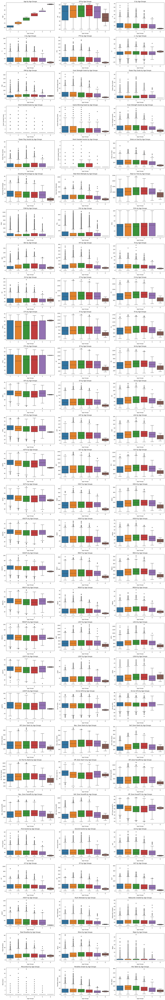

In [709]:
# Select numeric columns, excluding the specified column
numeric_columns = df_players.select_dtypes(include=['int32', 'float64']).columns
exclude_col = 'Age Groups'

# Create a list of columns excluding the specified column
columns_to_plot = [col for col in numeric_columns if col != exclude_col]

# Determine the number of rows and columns for the subplot grid
n_cols = 3  # Number of columns in the grid
n_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed

# Create the grid of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 120))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns to plot and axes together
for col, ax in zip(columns_to_plot, axes):
    sns.boxplot(x=df_players[exclude_col], y=df_players[col], ax=ax)
    ax.set_title(f'{col} by {exclude_col}')  # Set titles

# Remove any unused subplots (if any)
for i in range(len(columns_to_plot), len(axes)):
    fig.delaxes(axes[i])

# Display the plots
plt.tight_layout()
plt.show()

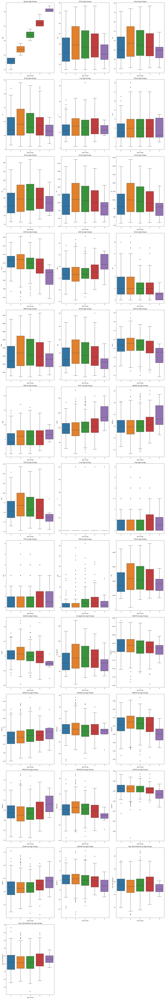

In [710]:
# Select numeric columns, excluding the specified column
numeric_columns = df_goalies.select_dtypes(include=['int32', 'float64']).columns
exclude_col = 'Age Groups'

# Create a list of columns excluding the specified column
columns_to_plot = [col for col in numeric_columns if col != exclude_col]

# Determine the number of rows and columns for the subplot grid
n_cols = 3  # Number of columns in the grid
n_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed

# Create the grid of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 120))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns to plot and axes together
for col, ax in zip(columns_to_plot, axes):
    sns.boxplot(x=df_goalies[exclude_col], y=df_goalies[col], ax=ax)
    ax.set_title(f'{col} by {exclude_col}')  # Set titles

# Remove any unused subplots (if any)
for i in range(len(columns_to_plot), len(axes)):
    fig.delaxes(axes[i])

# Display the plots
plt.tight_layout()
plt.show()

In [711]:
end_year = df_players['Season'].str[-2:].astype(int)
end_year = end_year.apply(lambda x: 2000 + x if x < 50 else 1900 + x)
df_players['Season_Final_Part'] = end_year

end_year = df_goalies['Season'].str[-2:].astype(int)
end_year = end_year.apply(lambda x: 2000 + x if x < 50 else 1900 + x)
df_goalies['Season_Final_Part'] = end_year

In [712]:
df_players['Total_Years_In_League'] = df_players['Season_Final_Part'] - df_players['Debut Year']
df_goalies['Total_Years_In_League'] = df_goalies['Season_Final_Part'] - df_goalies['Debut Year']

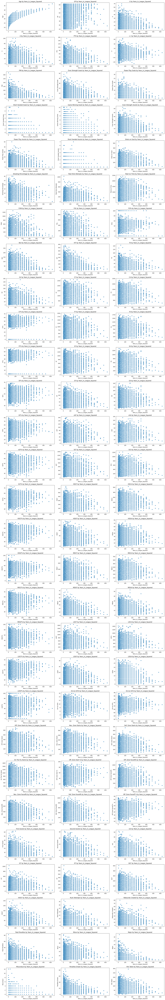

In [713]:
df_players['Years_In_League_Squared'] = df_players['Total_Years_In_League'] ** 2

# Select numeric columns, excluding the specified column
numeric_columns = df_players.select_dtypes(include=['int32', 'float64']).columns
exclude_col = 'Years_In_League_Squared'

# Create a list of columns excluding the specified column
columns_to_plot = [col for col in numeric_columns if col != exclude_col]

# Determine the number of rows and columns for the subplot grid
n_cols = 3  # Number of columns in the grid
n_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed

# Create the grid of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 120))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns to plot and axes together
for col, ax in zip(columns_to_plot, axes):
    sns.scatterplot(x=df_players[exclude_col], y=df_players[col], ax=ax)
    ax.set_title(f'{col} by {exclude_col}')  # Set titles

# Remove any unused subplots (if any)
for i in range(len(columns_to_plot), len(axes)):
    fig.delaxes(axes[i])

# Display the plots
plt.tight_layout()
plt.show()

In [714]:
df_forawrds = df_players[df_players['Position'] != 'D']
df_defence = df_players[df_players['Position'] == 'D']

In [715]:
df_forawrds['Average Time on Ice (minutes)'] = df_forawrds['Average Time on Ice'].dt.total_seconds() / 60

def ice_time_classifications(x):
    if x < 13:
        return '4th line forward'
    elif x >= 13 and x < 16:
        return '3rd line forward'
    elif x >= 16 and x < 18:
        return '2nd line forward'
    else:
        return '1st line forward'
    
df_forawrds['Average Time on Ice (minutes)'] = df_forawrds['Average Time on Ice (minutes)'].apply(ice_time_classifications)

C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\2798661475.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_forawrds['Average Time on Ice (minutes)'] = df_forawrds['Average Time on Ice'].dt.total_seconds() / 60
C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\2798661475.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_forawrds['Average Time on Ice (minutes)'] = df_forawrds['Average Time on Ice (minutes)'].apply(ice_time_classifications)


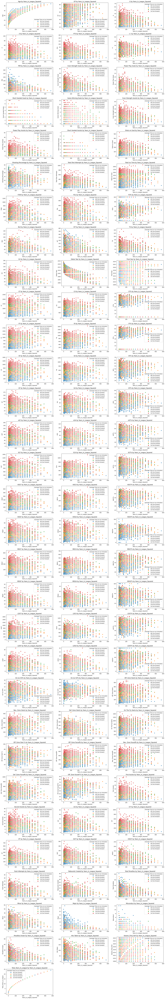

In [716]:
# Select numeric columns, excluding the specified column
numeric_columns = df_forawrds.select_dtypes(include=['int32', 'float64', 'int64', 'float32']).columns
exclude_col = 'Years_In_League_Squared'

# Create a list of columns excluding the specified column
columns_to_plot = [col for col in numeric_columns if col != exclude_col]

# Determine the number of rows and columns for the subplot grid
n_cols = 3  # Number of columns in the grid
n_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed

# Create the grid of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 120))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns to plot and axes together
for col, ax in zip(columns_to_plot, axes):
    sns.scatterplot(x=df_forawrds[exclude_col], y=df_forawrds[col], hue=df_forawrds['Average Time on Ice (minutes)'], ax=ax)
    ax.set_title(f'{col} by {exclude_col}')  # Set titles

# Remove any unused subplots (if any)
for i in range(len(columns_to_plot), len(axes)):
    fig.delaxes(axes[i])

# Display the plots
plt.tight_layout()
plt.show()

## Quadratic Regression

In [717]:
# 1. Prepare the data
df_forawrds['Age_Squared'] = df_forawrds['Age'] ** 2
df_forawrds['Years_In_League_Squared'] = df_forawrds['Total_Years_In_League'] ** 2
df_forawrds['Age_Years_Interaction'] = df_forawrds['Age'] * df_forawrds['Total_Years_In_League']

# 2. Define the independent variables (inputs) and dependent variable (output)
X = df_forawrds[['Age', 'Total_Years_In_League', 'Age_Squared', 'Years_In_League_Squared', 'Age_Years_Interaction']]
y = 0.2 * df_forawrds['PTS'] + 0.2 * df_forawrds['SCF']  + 0.2 * df_forawrds['CF'] + 0.2 * df_forawrds['FF'] + 0.2 * (df_forawrds['GV'] - df_forawrds['TK'])

# 3. Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 4. Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Add a constant (intercept) to the model
X_train_scaled = sm.add_constant(X_train_scaled)
X_test_scaled = sm.add_constant(X_test_scaled)

# 5. Fit the quadratic regression model
model = sm.OLS(y_train, X_train_scaled).fit()

# 6. Output the summary of the regression
print("Training Data Model Summary:")
print(model.summary())

# 7. Predict and evaluate on test data
y_pred = model.predict(X_test_scaled)

# Print model evaluation metrics
from sklearn.metrics import mean_squared_error, r2_score

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse}")
print(f"R-squared: {r2}")

Training Data Model Summary:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.153
Model:                            OLS   Adj. R-squared:                  0.152
Method:                 Least Squares   F-statistic:                     185.9
Date:                Fri, 30 Aug 2024   Prob (F-statistic):          1.61e-182
Time:                        13:30:34   Log-Likelihood:                -34695.
No. Observations:                5158   AIC:                         6.940e+04
Df Residuals:                    5152   BIC:                         6.944e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        431.9257  

C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\3000140526.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_forawrds['Age_Squared'] = df_forawrds['Age'] ** 2
C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\3000140526.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_forawrds['Years_In_League_Squared'] = df_forawrds['Total_Years_In_League'] ** 2
C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\3000140526.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

In [718]:
df_defence['Average Time on Ice (minutes)'] = df_defence['Average Time on Ice'].dt.total_seconds() / 60

def ice_time_classifications2(x):
    if x < 17:
        return '3rd line defence'
    elif x >= 17 and x < 21:
        return '2nd line defence'
    else:
        return '1st line defence'
    
df_defence['Average Time on Ice (minutes)'] = df_defence['Average Time on Ice (minutes)'].apply(ice_time_classifications2)

C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\622963906.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_defence['Average Time on Ice (minutes)'] = df_defence['Average Time on Ice'].dt.total_seconds() / 60
C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\622963906.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_defence['Average Time on Ice (minutes)'] = df_defence['Average Time on Ice (minutes)'].apply(ice_time_classifications2)


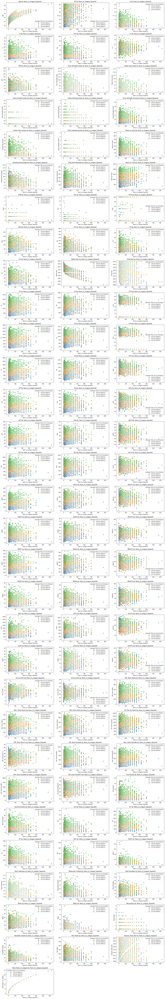

In [719]:
# Select numeric columns, excluding the specified column
numeric_columns = df_defence.select_dtypes(include=['int32', 'float64', 'int64', 'float32']).columns
exclude_col = 'Years_In_League_Squared'

# Create a list of columns excluding the specified column
columns_to_plot = [col for col in numeric_columns if col != exclude_col]

# Determine the number of rows and columns for the subplot grid
n_cols = 3  # Number of columns in the grid
n_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed

# Create the grid of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 120))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns to plot and axes together
for col, ax in zip(columns_to_plot, axes):
    sns.scatterplot(x=df_defence[exclude_col], y=df_defence[col], hue=df_defence['Average Time on Ice (minutes)'], ax=ax)
    ax.set_title(f'{col} by {exclude_col}')  # Set titles

# Remove any unused subplots (if any)
for i in range(len(columns_to_plot), len(axes)):
    fig.delaxes(axes[i])

# Display the plots
plt.tight_layout()
plt.show()

In [720]:
# 1. Prepare the data
df_defence['Age_Squared'] = df_defence['Age'] ** 2
df_defence['Years_In_League_Squared'] = df_defence['Total_Years_In_League'] ** 2
df_defence['Age_Years_Interaction'] = df_defence['Age'] * df_defence['Total_Years_In_League']

# 2. Define the independent variables (inputs) and dependent variable (output)
X = df_defence[['Age', 'Total_Years_In_League', 'Age_Squared', 'Years_In_League_Squared', 'Age_Years_Interaction']]
y = (1/7) * df_defence['PTS'] + (1/7) * df_defence['BLK']  + (1/7) * df_defence['xGA'] + (1/7) * df_defence['SCA'] + (1/7) * df_defence['TK'] + (1/7) * df_defence['HIT'] + (1/7) * df_defence['MDGA']

# 3. Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 4. Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Add a constant (intercept) to the model
X_train_scaled = sm.add_constant(X_train_scaled)
X_test_scaled = sm.add_constant(X_test_scaled)

# 5. Fit the quadratic regression model
model = sm.OLS(y_train, X_train_scaled).fit()

# 6. Output the summary of the regression
print("Training Data Model Summary:")
print(model.summary())

# 7. Predict and evaluate on test data
y_pred = model.predict(X_test_scaled)

# Print model evaluation metrics
from sklearn.metrics import mean_squared_error, r2_score

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse}")
print(f"R-squared: {r2}")

Training Data Model Summary:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.100
Model:                            OLS   Adj. R-squared:                  0.098
Method:                 Least Squares   F-statistic:                     62.17
Date:                Fri, 30 Aug 2024   Prob (F-statistic):           1.21e-61
Time:                        13:31:02   Log-Likelihood:                -14758.
No. Observations:                2809   AIC:                         2.953e+04
Df Residuals:                    2803   BIC:                         2.956e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        115.7900  

C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\2206803478.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_defence['Age_Squared'] = df_defence['Age'] ** 2
C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\2206803478.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_defence['Years_In_League_Squared'] = df_defence['Total_Years_In_League'] ** 2
C:\Users\gabri\AppData\Local\Temp\ipykernel_11400\2206803478.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFr

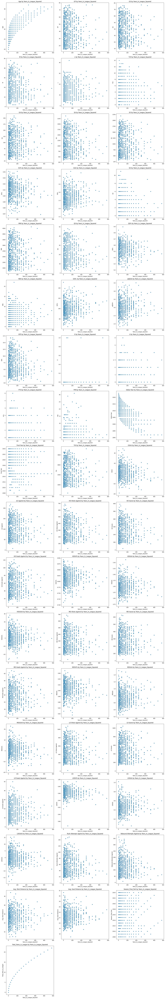

In [721]:
df_goalies['Years_In_League_Squared'] = df_goalies['Total_Years_In_League'] ** 2
# Select numeric columns, excluding the specified column
numeric_columns = df_goalies.select_dtypes(include=['int32', 'float64', 'int64', 'float32']).columns
exclude_col = 'Years_In_League_Squared'

# Create a list of columns excluding the specified column
columns_to_plot = [col for col in numeric_columns if col != exclude_col]

# Determine the number of rows and columns for the subplot grid
n_cols = 3  # Number of columns in the grid
n_rows = math.ceil(len(columns_to_plot) / n_cols)  # Calculate rows needed

# Create the grid of subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 120))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns to plot and axes together
for col, ax in zip(columns_to_plot, axes):
    sns.scatterplot(x=df_goalies[exclude_col], y=df_goalies[col], ax=ax)
    ax.set_title(f'{col} by {exclude_col}')  # Set titles

# Remove any unused subplots (if any)
for i in range(len(columns_to_plot), len(axes)):
    fig.delaxes(axes[i])

# Display the plots
plt.tight_layout()
plt.show()

In [722]:
# 1. Prepare the data
df_goalies['Age_Squared'] = df_goalies['Age'] ** 2
df_goalies['Years_In_League_Squared'] = df_goalies['Total_Years_In_League'] ** 2
df_goalies['Age_Years_Interaction'] = df_goalies['Age'] * df_goalies['Total_Years_In_League']

# 2. Define the independent variables (inputs) and dependent variable (output)
X = df_goalies[['Age', 'Total_Years_In_League', 'Age_Squared', 'Years_In_League_Squared', 'Age_Years_Interaction']]
y = (1/3) * df_goalies['LDGSAA'] + (1/3) * df_goalies['MDGSAA'] + (1/3) * df_goalies['HDGSAA'] 

# 3. Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 4. Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Add a constant (intercept) to the model
X_train_scaled = sm.add_constant(X_train_scaled)
X_test_scaled = sm.add_constant(X_test_scaled)

# 5. Fit the quadratic regression model
model = sm.OLS(y_train, X_train_scaled).fit()

# 6. Output the summary of the regression
print("Training Data Model Summary:")
print(model.summary())

# 7. Predict and evaluate on test data
y_pred = model.predict(X_test_scaled)

# Print model evaluation metrics
from sklearn.metrics import mean_squared_error, r2_score

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse}")
print(f"R-squared: {r2}")

Training Data Model Summary:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.025
Model:                            OLS   Adj. R-squared:                  0.018
Method:                 Least Squares   F-statistic:                     3.426
Date:                Fri, 30 Aug 2024   Prob (F-statistic):            0.00459
Time:                        13:31:11   Log-Likelihood:                -1902.5
No. Observations:                 678   AIC:                             3817.
Df Residuals:                     672   BIC:                             3844.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.4139  